On the sdf login node
```
[youtsumi@sdf-login02 u]$ source /cvmfs/sw.lsst.eu/linux-x86_64/lsst_distrib/w_2021_51/loadLSST.bash                                                                                                        [89/89]
(lsst-scipipe-0.7.0-ext) [youtsumi@sdf-login02 u]$ setup lsst_distrib
(lsst-scipipe-0.7.0-ext) [youtsumi@sdf-login02 u]$ jupyter lab
```

Needs an ssh tunnel in a separate window

In [1]:
! eups list -s lsst_distrib

   g7ae64ea4b3+cca76d10ca 	w_latest w_2021_52 current setup


In [2]:
import sys
sys.path.append("/sdf/group/lsst/camera/IandT/repo_gen3/spot_test_v2/u/youtsumi/202112/mixcoatl/python")

In [3]:
import numpy
import pylab as plt
import pylab

# Stack imports
from lsst.daf.butler import Butler
import lsst.afw.display as afwDisplay
import lsst.meas.extensions.shapeHSM
import lsst.afw.image as afwImage
from lsst.ip.isr.isrTask import IsrTask
from mixcoatl.characterizeSpots import CharacterizeSpotsTask
from mixcoatl.gridFitTask import GridFitTask

import logging
logging.basicConfig()
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

/sdf/group/lsst/camera/IandT/repo_gen3/spot_test_v2/u/youtsumi/202112/mixcoatl/python/mixcoatl/characterizeSpots.py:136: FutureWarning: Call to deprecated function (or staticmethod) timeMethod. (timeMethod has been replaced by lsst.utils.timer.timeMethod. Will be removed after v25.) -- Deprecated since version v24.
  def run(self, exposure, exposureIdInfo=None):


In [4]:
def display(exposure,title=None):
    afwDisplay.setDefaultBackend('matplotlib') 
    fig = plt.figure(figsize=(10,10),facecolor="white")
    afw_display = afwDisplay.Display(1)
    afw_display.scale('asinh', 'zscale')
    afw_display.mtv(exposure.getImage())
    plt.title(title)
    plt.gca().axis('off')

In [5]:
repo_path = "/sdf/group/lsst/camera/IandT/repo_gen3/BOT_data/"
butler = Butler(repo_path)

# collections=["u/abrought/run_13231/R02_S00/uncorrected","u/abrought/run_13230/R02_S00/uncorrected"]
butler = Butler(repo_path,collections=collections)
registry = butler.registry

In [7]:
print(registry)

PostgreSQL@rubin:bot_data_w_2021_43


In [8]:
butler = Butler(repo_path)
registry = butler.registry
for c in registry.queryCollections():
    print(c)    

LSSTCam/calib
LSSTCam/calib/unbounded
LSSTCam/raw/all
LSSTCam/photodiode/all
u/snyder18/crosstalk_13169/sbias
u/snyder18/crosstalk_13169/sbias/20211215T191900Z
u/snyder18/crosstalk_13169/calib
u/snyder18/crosstalk_13169/crosstalk_spot
u/snyder18/crosstalk_13175/sbias
u/snyder18/crosstalk_13175/sbias/20211217T211636Z
u/snyder18/crosstalk_13186/sbias
u/snyder18/crosstalk_13186/sbias/20211217T225138Z
u/snyder18/crosstalk_13175/calib
u/snyder18/crosstalk_13169/crosstalk_spot/20211218T003408Z
u/snyder18/crosstalk_13175/crosstalk_spot
u/snyder18/crosstalk_13186/calib
u/snyder18/crosstalk_13175/crosstalk_spot/20211218T225100Z
u/snyder18/crosstalk_13186/crosstalk_spot
u/snyder18/crosstalk_13186/crosstalk_spot/20211220T023605Z
u/snyder18/crosstalk_13198/sbias
u/snyder18/crosstalk_13198/sbias/20211220T182307Z
u/snyder18/crosstalk_13198/calib
u/snyder18/crosstalk_13200/sbias
u/snyder18/crosstalk_13200/sbias/20211220T215856Z
u/snyder18/crosstalk_13200/calib
u/snyder18/crosstalk_13200/crosstalk_spo

In [9]:
# then explore the inside of the collection
subbutler = Butler(repo_path,collections=collections)
subregistry = subbutler.registry
for dtype in subregistry.queryDatasetTypes():
    try:
        datasetRefs = list(subregistry.queryDatasets(datasetType=dtype,collections=collections))        
        print(len(datasetRefs), dtype )
    except:
        print("Error", dtype )

0 DatasetType('camera', {instrument}, Camera, isCalibration=True)
3253972 DatasetType('raw', {band, instrument, detector, physical_filter, exposure}, Exposure)
0 DatasetType('photodiode', {band, instrument, physical_filter, exposure}, AstropyTable)
0 DatasetType('cpBiasProc', {band, instrument, detector, physical_filter, exposure}, Exposure)
700 DatasetType('isr_metadata', {band, instrument, detector, physical_filter, exposure}, PropertySet)
0 DatasetType('bias', {instrument, detector}, ExposureF, isCalibration=True)
0 DatasetType('cpCombine_metadata', {instrument, detector}, PropertySet)
2 DatasetType('isr_config', {}, Config)
0 DatasetType('cpCombine_config', {}, Config)
2 DatasetType('packages', {}, Packages)
0 DatasetType('cpCrosstalkProc', {band, instrument, detector, physical_filter, exposure}, Exposure)
0 DatasetType('crosstalkBackgroundZOffsets', {band, instrument, detector, physical_filter, exposure}, StructuredDataDict)
0 DatasetType('crosstalkBackgroundYTilts', {band, instru

In [10]:
where = """
instrument='LSSTCam'
and detector=9
"""
#and exposure.observation_type = 'spot'
#and exposure.science_program IN ('13232','13234')

datasetRefs = list(subregistry.queryDatasets(
    datasetType="gridSpotSrc",
    collections=collections,
    where=where)
                  )
results = []

for aref in datasetRefs:
    try:
        # get a catalog from the butler
        src = subbutler.get(aref)
        # get the associated metadata from raw data which contains EXPTIME
        raw = subbutler.get("raw",dataId=aref.dataId)
        img = raw.getImage().getArray()
        md = raw.getMetadata()
        # stores into memory for later use

        # Get the peak spot values
        peakSignal = numpy.zeros(len(src))
        s = 15
        if len(src) > 0:
            postisr = subbutler.get("postISRCCD",dataId=aref.dataId)
#            postisr = subbutler.get("raw",dataId=aref.dataId)
            image = postisr.getImage().getArray()
            #image = raw.getImage().getArray()
            for i,pt in enumerate(src["spotgrid_index"]):
                x = int(src['base_SdssCentroid_y'][i]) # The coordinate systems are flipped
                y = int(src['base_SdssCentroid_x'][i])

                xmin = max(0,x-s)
                xmax = min(image.shape[0]-1, x+s)
                ymin = max(0,y-s)
                ymax = min(image.shape[1]-1, y+s)
                peakSignal[i] = numpy.max(image[xmin:xmax,ymin:ymax])
    
        newsrc=src.asAstropy()
        newsrc.add_column(peakSignal ,name="peakSignal")
        results.append( {"md": md, "src":newsrc} )
    except:
#        raise
        pass

In [11]:
results[0]["src"]

id,coord_ra,coord_dec,parent,base_SdssCentroid_x,base_SdssCentroid_y,base_SdssCentroid_xErr,base_SdssCentroid_yErr,base_SdssCentroid_flag,base_SdssCentroid_flag_edge,base_SdssCentroid_flag_noSecondDerivative,base_SdssCentroid_flag_almostNoSecondDerivative,base_SdssCentroid_flag_notAtMaximum,base_SdssCentroid_flag_resetToPeak,base_SdssCentroid_flag_badError,base_SdssShape_xx,base_SdssShape_yy,base_SdssShape_xy,base_SdssShape_xxErr,base_SdssShape_yyErr,base_SdssShape_xyErr,base_SdssShape_x,base_SdssShape_y,base_SdssShape_instFlux,base_SdssShape_instFluxErr,base_SdssShape_psf_xx,base_SdssShape_psf_yy,base_SdssShape_psf_xy,base_SdssShape_instFlux_xx_Cov,base_SdssShape_instFlux_yy_Cov,base_SdssShape_instFlux_xy_Cov,base_SdssShape_flag,base_SdssShape_flag_unweightedBad,base_SdssShape_flag_unweighted,base_SdssShape_flag_shift,base_SdssShape_flag_maxIter,base_SdssShape_flag_psf,ext_shapeHSM_HsmPsfMoments_x,ext_shapeHSM_HsmPsfMoments_y,ext_shapeHSM_HsmPsfMoments_xx,ext_shapeHSM_HsmPsfMoments_yy,ext_shapeHSM_HsmPsfMoments_xy,ext_shapeHSM_HsmPsfMoments_flag,ext_shapeHSM_HsmPsfMoments_flag_no_pixels,ext_shapeHSM_HsmPsfMoments_flag_not_contained,ext_shapeHSM_HsmPsfMoments_flag_parent_source,ext_shapeHSM_HsmPsfMoments_flag_galsim,ext_shapeHSM_HsmPsfMoments_flag_edge,ext_shapeHSM_HsmShapeBj_e1,ext_shapeHSM_HsmShapeBj_e2,ext_shapeHSM_HsmShapeBj_sigma,ext_shapeHSM_HsmShapeBj_resolution,ext_shapeHSM_HsmShapeBj_flag,ext_shapeHSM_HsmShapeBj_flag_no_pixels,ext_shapeHSM_HsmShapeBj_flag_not_contained,ext_shapeHSM_HsmShapeBj_flag_parent_source,ext_shapeHSM_HsmShapeBj_flag_galsim,ext_shapeHSM_HsmShapeKsb_g1,ext_shapeHSM_HsmShapeKsb_g2,ext_shapeHSM_HsmShapeKsb_sigma,ext_shapeHSM_HsmShapeKsb_resolution,ext_shapeHSM_HsmShapeKsb_flag,ext_shapeHSM_HsmShapeKsb_flag_no_pixels,ext_shapeHSM_HsmShapeKsb_flag_not_contained,ext_shapeHSM_HsmShapeKsb_flag_parent_source,ext_shapeHSM_HsmShapeKsb_flag_galsim,ext_shapeHSM_HsmShapeLinear_e1,ext_shapeHSM_HsmShapeLinear_e2,ext_shapeHSM_HsmShapeLinear_sigma,ext_shapeHSM_HsmShapeLinear_resolution,ext_shapeHSM_HsmShapeLinear_flag,ext_shapeHSM_HsmShapeLinear_flag_no_pixels,ext_shapeHSM_HsmShapeLinear_flag_not_contained,ext_shapeHSM_HsmShapeLinear_flag_parent_source,ext_shapeHSM_HsmShapeLinear_flag_galsim,ext_shapeHSM_HsmShapeRegauss_e1,ext_shapeHSM_HsmShapeRegauss_e2,ext_shapeHSM_HsmShapeRegauss_sigma,ext_shapeHSM_HsmShapeRegauss_resolution,ext_shapeHSM_HsmShapeRegauss_flag,ext_shapeHSM_HsmShapeRegauss_flag_no_pixels,ext_shapeHSM_HsmShapeRegauss_flag_not_contained,ext_shapeHSM_HsmShapeRegauss_flag_parent_source,ext_shapeHSM_HsmShapeRegauss_flag_galsim,ext_shapeHSM_HsmSourceMoments_x,ext_shapeHSM_HsmSourceMoments_y,ext_shapeHSM_HsmSourceMoments_xx,ext_shapeHSM_HsmSourceMoments_yy,ext_shapeHSM_HsmSourceMoments_xy,ext_shapeHSM_HsmSourceMoments_flag,ext_shapeHSM_HsmSourceMoments_flag_no_pixels,ext_shapeHSM_HsmSourceMoments_flag_not_contained,ext_shapeHSM_HsmSourceMoments_flag_parent_source,ext_shapeHSM_HsmSourceMoments_flag_galsim,ext_shapeHSM_HsmSourceMoments_flag_edge,base_CircularApertureFlux_3_0_instFlux,base_CircularApertureFlux_3_0_instFluxErr,base_CircularApertureFlux_3_0_flag,base_CircularApertureFlux_3_0_flag_apertureTruncated,base_CircularApertureFlux_3_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_4_5_instFlux,base_CircularApertureFlux_4_5_instFluxErr,base_CircularApertureFlux_4_5_flag,base_CircularApertureFlux_4_5_flag_apertureTruncated,base_CircularApertureFlux_4_5_flag_sincCoeffsTruncated,base_CircularApertureFlux_6_0_instFlux,base_CircularApertureFlux_6_0_instFluxErr,base_CircularApertureFlux_6_0_flag,base_CircularApertureFlux_6_0_flag_apertureTruncated,base_CircularApertureFlux_6_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_9_0_instFlux,base_CircularApertureFlux_9_0_instFluxErr,base_CircularApertureFlux_9_0_flag,base_CircularApertureFlux_9_0_flag_apertureTruncated,base_CircularApertureFlux_9_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_12_0_instFlux,base_CircularApertureFlux_12_0_instFluxErr

In [12]:
from astropy.table import vstack, join
faint = []
for aresult in results:
    if aresult["md"]["EXPTIME"]>13:
        continue
    faint.append(aresult["src"])
mean_data_table = vstack(faint, join_type='exact')

mean_data_table_by_groups = mean_data_table[ numpy.where(
        (mean_data_table["spotgrid_index"]>=0) &
        (mean_data_table["base_PixelFlags_flag"]==False) &
        (mean_data_table["base_PsfFlux_flag"]==False) &
        (mean_data_table["base_SdssCentroid_flag"]==False) &
        (mean_data_table["base_CircularApertureFlux_70_0_flag_apertureTruncated"]==False) &
        (mean_data_table["spotgrid_x"]<3800) &
        (mean_data_table["spotgrid_y"]<3800) &
        (mean_data_table["spotgrid_x"]>200) &
        (mean_data_table["spotgrid_y"]>200)
    )].group_by('spotgrid_index')
ref = mean_data_table_by_groups.groups.aggregate(numpy.nanmedian)
ref

/cvmfs/sw.lsst.eu/linux-x86_64/lsst_distrib/w_2021_52/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-0.7.0-ext/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


id,coord_ra,coord_dec,parent,base_SdssCentroid_x,base_SdssCentroid_y,base_SdssCentroid_xErr,base_SdssCentroid_yErr,base_SdssCentroid_flag,base_SdssCentroid_flag_edge,base_SdssCentroid_flag_noSecondDerivative,base_SdssCentroid_flag_almostNoSecondDerivative,base_SdssCentroid_flag_notAtMaximum,base_SdssCentroid_flag_resetToPeak,base_SdssCentroid_flag_badError,base_SdssShape_xx,base_SdssShape_yy,base_SdssShape_xy,base_SdssShape_xxErr,base_SdssShape_yyErr,base_SdssShape_xyErr,base_SdssShape_x,base_SdssShape_y,base_SdssShape_instFlux,base_SdssShape_instFluxErr,base_SdssShape_psf_xx,base_SdssShape_psf_yy,base_SdssShape_psf_xy,base_SdssShape_instFlux_xx_Cov,base_SdssShape_instFlux_yy_Cov,base_SdssShape_instFlux_xy_Cov,base_SdssShape_flag,base_SdssShape_flag_unweightedBad,base_SdssShape_flag_unweighted,base_SdssShape_flag_shift,base_SdssShape_flag_maxIter,base_SdssShape_flag_psf,ext_shapeHSM_HsmPsfMoments_x,ext_shapeHSM_HsmPsfMoments_y,ext_shapeHSM_HsmPsfMoments_xx,ext_shapeHSM_HsmPsfMoments_yy,ext_shapeHSM_HsmPsfMoments_xy,ext_shapeHSM_HsmPsfMoments_flag,ext_shapeHSM_HsmPsfMoments_flag_no_pixels,ext_shapeHSM_HsmPsfMoments_flag_not_contained,ext_shapeHSM_HsmPsfMoments_flag_parent_source,ext_shapeHSM_HsmPsfMoments_flag_galsim,ext_shapeHSM_HsmPsfMoments_flag_edge,ext_shapeHSM_HsmShapeBj_e1,ext_shapeHSM_HsmShapeBj_e2,ext_shapeHSM_HsmShapeBj_sigma,ext_shapeHSM_HsmShapeBj_resolution,ext_shapeHSM_HsmShapeBj_flag,ext_shapeHSM_HsmShapeBj_flag_no_pixels,ext_shapeHSM_HsmShapeBj_flag_not_contained,ext_shapeHSM_HsmShapeBj_flag_parent_source,ext_shapeHSM_HsmShapeBj_flag_galsim,ext_shapeHSM_HsmShapeKsb_g1,ext_shapeHSM_HsmShapeKsb_g2,ext_shapeHSM_HsmShapeKsb_sigma,ext_shapeHSM_HsmShapeKsb_resolution,ext_shapeHSM_HsmShapeKsb_flag,ext_shapeHSM_HsmShapeKsb_flag_no_pixels,ext_shapeHSM_HsmShapeKsb_flag_not_contained,ext_shapeHSM_HsmShapeKsb_flag_parent_source,ext_shapeHSM_HsmShapeKsb_flag_galsim,ext_shapeHSM_HsmShapeLinear_e1,ext_shapeHSM_HsmShapeLinear_e2,ext_shapeHSM_HsmShapeLinear_sigma,ext_shapeHSM_HsmShapeLinear_resolution,ext_shapeHSM_HsmShapeLinear_flag,ext_shapeHSM_HsmShapeLinear_flag_no_pixels,ext_shapeHSM_HsmShapeLinear_flag_not_contained,ext_shapeHSM_HsmShapeLinear_flag_parent_source,ext_shapeHSM_HsmShapeLinear_flag_galsim,ext_shapeHSM_HsmShapeRegauss_e1,ext_shapeHSM_HsmShapeRegauss_e2,ext_shapeHSM_HsmShapeRegauss_sigma,ext_shapeHSM_HsmShapeRegauss_resolution,ext_shapeHSM_HsmShapeRegauss_flag,ext_shapeHSM_HsmShapeRegauss_flag_no_pixels,ext_shapeHSM_HsmShapeRegauss_flag_not_contained,ext_shapeHSM_HsmShapeRegauss_flag_parent_source,ext_shapeHSM_HsmShapeRegauss_flag_galsim,ext_shapeHSM_HsmSourceMoments_x,ext_shapeHSM_HsmSourceMoments_y,ext_shapeHSM_HsmSourceMoments_xx,ext_shapeHSM_HsmSourceMoments_yy,ext_shapeHSM_HsmSourceMoments_xy,ext_shapeHSM_HsmSourceMoments_flag,ext_shapeHSM_HsmSourceMoments_flag_no_pixels,ext_shapeHSM_HsmSourceMoments_flag_not_contained,ext_shapeHSM_HsmSourceMoments_flag_parent_source,ext_shapeHSM_HsmSourceMoments_flag_galsim,ext_shapeHSM_HsmSourceMoments_flag_edge,base_CircularApertureFlux_3_0_instFlux,base_CircularApertureFlux_3_0_instFluxErr,base_CircularApertureFlux_3_0_flag,base_CircularApertureFlux_3_0_flag_apertureTruncated,base_CircularApertureFlux_3_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_4_5_instFlux,base_CircularApertureFlux_4_5_instFluxErr,base_CircularApertureFlux_4_5_flag,base_CircularApertureFlux_4_5_flag_apertureTruncated,base_CircularApertureFlux_4_5_flag_sincCoeffsTruncated,base_CircularApertureFlux_6_0_instFlux,base_CircularApertureFlux_6_0_instFluxErr,base_CircularApertureFlux_6_0_flag,base_CircularApertureFlux_6_0_flag_apertureTruncated,base_CircularApertureFlux_6_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_9_0_instFlux,base_CircularApertureFlux_9_0_instFluxErr,base_CircularApertureFlux_9_0_flag,base_CircularApertureFlux_9_0_flag_apertureTruncated,base_CircularApertureFlux_9_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_12_0_instFlux,base_CircularApertureFlux_12_0_instFluxErr

In [13]:
exparray = numpy.array([ aresult["md"]["EXPTIME"] for aresult in results ])
exptime=list(set(exparray))

In [14]:
exparray[ numpy.argmin(exparray) ]

1.25

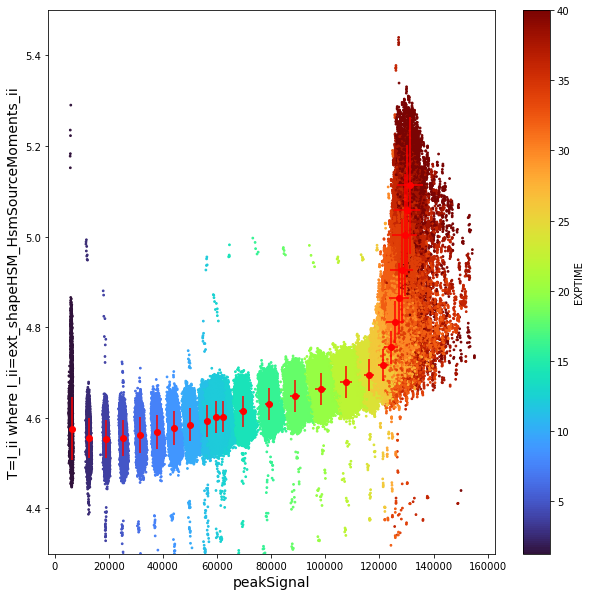

In [135]:
fontsize=14
fig = plt.figure(figsize=(10,10),facecolor="white")

#ykey="ext_shapeHSM_HsmShapeRegauss_sigma"
ykey="base_SdssShape_xx"
#ykey="ext_shapeHSM_HsmSourceMoments_xx"
y2key="base_SdssShape_yy"
#y2key="ext_shapeHSM_HsmSourceMoments_yy"
#xkey="base_CircularApertureFlux_50_0_instFlux"
xkey="peakSignal"
#xkey="base_SdssShape_instFlux"
x = []
y = []
e = []
                
                
for aresult in results[:]:
#    cond = ( aresult["src"]["spotgrid_index"]>=0 ) & ( aresult["src"]["spotgrid_normalized_dx"]**2+aresult["src"]["spotgrid_normalized_dy"]**2<0.002**2 )
    cond = (
        (aresult["src"]["spotgrid_index"]>=0) &
        (aresult["src"]["base_CircularApertureFlux_70_0_instFlux"]>numpy.nanmax(aresult["src"]["base_CircularApertureFlux_70_0_instFlux"])*0.9)
#       & ((aresult["src"]["spotgrid_x"]-aresult["src"]["base_SdssCentroid_x"])**2+(aresult["src"]["spotgrid_y"]-aresult["src"]["base_SdssCentroid_y"])**2<1**2)   # cut to reject mis-paired sources
        )
    x.extend(aresult["src"][xkey][cond])
##    y.extend((aresult["src"][ykey]+aresult["src"][y2key])[cond])
    y.extend((aresult["src"][ykey])[cond])
    e.extend([aresult["md"]["EXPTIME"]]*len(aresult["src"][xkey][cond]))
x=numpy.array(x)
y=numpy.array(y)
e=numpy.array(e)
ax=plt.scatter(x,y,c=e,s=3,cmap='turbo',alpha=1)
for i, _exptime in enumerate(list(set(e))):
    cond = numpy.where(e==_exptime)
    plt.errorbar(
        numpy.nanmedian(x[cond]),
        numpy.nanmedian(y[cond]),
        xerr=numpy.nanstd(x[cond]),
        yerr=numpy.nanstd(y[cond]),
        fmt="o",
        color="red"
    )
    
plt.xlabel(xkey,fontsize=fontsize)
plt.ylabel("{}".format("T=I_ii where I_ii=ext_shapeHSM_HsmSourceMoments_ii"),fontsize=fontsize)
#plt.xlim(1e4,0.4e7)
#plt.ylim(9.2,10.2)
plt.ylim(4.3,5.5)
#plt.ylim(1e4,1e8)
plt.colorbar(ax,label="EXPTIME")
#plt.loglog()
#plt.semilogx()


In [16]:
from astropy.table import vstack, join
faint = [ results[i]["src"] for i in  numpy.where(exparray == exptime[2] )[0] ] ### this determines which one from the faintest we are going to base on
mean_data_table = vstack(faint, join_type='exact')

mean_data_table_by_groups = mean_data_table[ numpy.where(
        (mean_data_table["spotgrid_index"]>=0)
    )].group_by('spotgrid_index')
ref = mean_data_table_by_groups.groups.aggregate(numpy.nanmedian)
ref

/cvmfs/sw.lsst.eu/linux-x86_64/lsst_distrib/w_2021_52/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-0.7.0-ext/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


id,coord_ra,coord_dec,parent,base_SdssCentroid_x,base_SdssCentroid_y,base_SdssCentroid_xErr,base_SdssCentroid_yErr,base_SdssCentroid_flag,base_SdssCentroid_flag_edge,base_SdssCentroid_flag_noSecondDerivative,base_SdssCentroid_flag_almostNoSecondDerivative,base_SdssCentroid_flag_notAtMaximum,base_SdssCentroid_flag_resetToPeak,base_SdssCentroid_flag_badError,base_SdssShape_xx,base_SdssShape_yy,base_SdssShape_xy,base_SdssShape_xxErr,base_SdssShape_yyErr,base_SdssShape_xyErr,base_SdssShape_x,base_SdssShape_y,base_SdssShape_instFlux,base_SdssShape_instFluxErr,base_SdssShape_psf_xx,base_SdssShape_psf_yy,base_SdssShape_psf_xy,base_SdssShape_instFlux_xx_Cov,base_SdssShape_instFlux_yy_Cov,base_SdssShape_instFlux_xy_Cov,base_SdssShape_flag,base_SdssShape_flag_unweightedBad,base_SdssShape_flag_unweighted,base_SdssShape_flag_shift,base_SdssShape_flag_maxIter,base_SdssShape_flag_psf,ext_shapeHSM_HsmPsfMoments_x,ext_shapeHSM_HsmPsfMoments_y,ext_shapeHSM_HsmPsfMoments_xx,ext_shapeHSM_HsmPsfMoments_yy,ext_shapeHSM_HsmPsfMoments_xy,ext_shapeHSM_HsmPsfMoments_flag,ext_shapeHSM_HsmPsfMoments_flag_no_pixels,ext_shapeHSM_HsmPsfMoments_flag_not_contained,ext_shapeHSM_HsmPsfMoments_flag_parent_source,ext_shapeHSM_HsmPsfMoments_flag_galsim,ext_shapeHSM_HsmPsfMoments_flag_edge,ext_shapeHSM_HsmShapeBj_e1,ext_shapeHSM_HsmShapeBj_e2,ext_shapeHSM_HsmShapeBj_sigma,ext_shapeHSM_HsmShapeBj_resolution,ext_shapeHSM_HsmShapeBj_flag,ext_shapeHSM_HsmShapeBj_flag_no_pixels,ext_shapeHSM_HsmShapeBj_flag_not_contained,ext_shapeHSM_HsmShapeBj_flag_parent_source,ext_shapeHSM_HsmShapeBj_flag_galsim,ext_shapeHSM_HsmShapeKsb_g1,ext_shapeHSM_HsmShapeKsb_g2,ext_shapeHSM_HsmShapeKsb_sigma,ext_shapeHSM_HsmShapeKsb_resolution,ext_shapeHSM_HsmShapeKsb_flag,ext_shapeHSM_HsmShapeKsb_flag_no_pixels,ext_shapeHSM_HsmShapeKsb_flag_not_contained,ext_shapeHSM_HsmShapeKsb_flag_parent_source,ext_shapeHSM_HsmShapeKsb_flag_galsim,ext_shapeHSM_HsmShapeLinear_e1,ext_shapeHSM_HsmShapeLinear_e2,ext_shapeHSM_HsmShapeLinear_sigma,ext_shapeHSM_HsmShapeLinear_resolution,ext_shapeHSM_HsmShapeLinear_flag,ext_shapeHSM_HsmShapeLinear_flag_no_pixels,ext_shapeHSM_HsmShapeLinear_flag_not_contained,ext_shapeHSM_HsmShapeLinear_flag_parent_source,ext_shapeHSM_HsmShapeLinear_flag_galsim,ext_shapeHSM_HsmShapeRegauss_e1,ext_shapeHSM_HsmShapeRegauss_e2,ext_shapeHSM_HsmShapeRegauss_sigma,ext_shapeHSM_HsmShapeRegauss_resolution,ext_shapeHSM_HsmShapeRegauss_flag,ext_shapeHSM_HsmShapeRegauss_flag_no_pixels,ext_shapeHSM_HsmShapeRegauss_flag_not_contained,ext_shapeHSM_HsmShapeRegauss_flag_parent_source,ext_shapeHSM_HsmShapeRegauss_flag_galsim,ext_shapeHSM_HsmSourceMoments_x,ext_shapeHSM_HsmSourceMoments_y,ext_shapeHSM_HsmSourceMoments_xx,ext_shapeHSM_HsmSourceMoments_yy,ext_shapeHSM_HsmSourceMoments_xy,ext_shapeHSM_HsmSourceMoments_flag,ext_shapeHSM_HsmSourceMoments_flag_no_pixels,ext_shapeHSM_HsmSourceMoments_flag_not_contained,ext_shapeHSM_HsmSourceMoments_flag_parent_source,ext_shapeHSM_HsmSourceMoments_flag_galsim,ext_shapeHSM_HsmSourceMoments_flag_edge,base_CircularApertureFlux_3_0_instFlux,base_CircularApertureFlux_3_0_instFluxErr,base_CircularApertureFlux_3_0_flag,base_CircularApertureFlux_3_0_flag_apertureTruncated,base_CircularApertureFlux_3_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_4_5_instFlux,base_CircularApertureFlux_4_5_instFluxErr,base_CircularApertureFlux_4_5_flag,base_CircularApertureFlux_4_5_flag_apertureTruncated,base_CircularApertureFlux_4_5_flag_sincCoeffsTruncated,base_CircularApertureFlux_6_0_instFlux,base_CircularApertureFlux_6_0_instFluxErr,base_CircularApertureFlux_6_0_flag,base_CircularApertureFlux_6_0_flag_apertureTruncated,base_CircularApertureFlux_6_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_9_0_instFlux,base_CircularApertureFlux_9_0_instFluxErr,base_CircularApertureFlux_9_0_flag,base_CircularApertureFlux_9_0_flag_apertureTruncated,base_CircularApertureFlux_9_0_flag_sincCoeffsTruncated,base_CircularApertureFlux_12_0_instFlux,base_CircularApertureFlux_12_0_instFluxErr

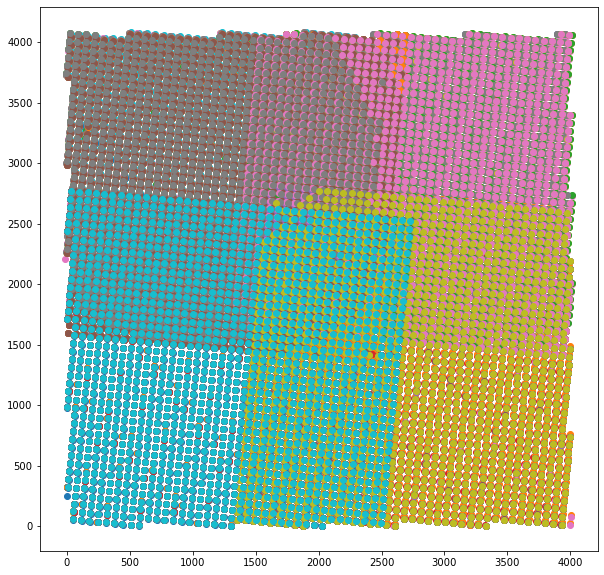

In [17]:
#pylab.scatter(
#    results[0]["src"]["spotgrid_x"],
#    results[0]["src"]["spotgrid_y"]
#)

fig = plt.figure(figsize=(10,10))

for i in range(100):
    pylab.scatter(
        results[i]["src"]["spotgrid_y"],
        results[i]["src"]["spotgrid_x"]
    )

#spotgrid_y	spotgrid_x	spotgrid_normalized_dy	spotgrid_normalized_dx	


In [18]:
import pandas
from astropy.table import Table
df=pandas.read_pickle("dfmerge_13144.pkl")
subdf = df[ df["BAY_SLOT"] == "R02_S00" ]
Table.from_pandas(subdf)

PTC_NOISE_ERROR,PTC_TURNOFF,PTC_GAIN_ERROR,PTC_A00,PTC_NOISE,PTC_A00_ERROR,PTC_GAIN,READ_NOISE,TOTAL_NOISE,SYSTEM_NOISE,BF_SLOPEX_ERR,BF_YCORR,BF_YCORR_ERR,BF_SLOPEY,BF_SLOPEX,BF_XCORR_ERR,BF_SLOPEY_ERR,BF_XCORR,BF_MEAN,BAY,SLOT,AMP,BAYTYPE,BAY_SLOT,SEGMENT,TYPE,CTI_TURNOFF,MEANMAX,useCTITURNOFF
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str3,str3,int64,str1,str7,str2,str3,float64,float64,bool
0.20190070569515228,76945.46875,0.002548166550695896,1.7940433281182777e-06,5.833096027374268,2.504396867664127e-08,1.6398268938064575,4.827574729919434,4.827574729919434,0.0,3.3503532904433087e-05,0.008300041779875755,0.0,0.00457792030647397,0.0014401626540347934,0.0,9.486314957030118e-05,0.0030486234463751316,0.0029806389939039946,R02,S00,1,S,R02_S00,10,itl,107377.7109375,107374.625,False
0.20660994946956635,75083.828125,0.002585252281278372,1.8312774727746728e-06,5.6970062255859375,2.5938579284456864e-08,1.6422665119171143,4.8967766761779785,4.8967766761779785,0.0,2.9725366402999498e-05,0.0150558240711689,0.0,0.00452398182824254,0.0014230823144316673,0.0,0.00010049709089798853,0.0157027468085289,0.0036956672556698322,R02,S00,2,S,R02_S00,11,itl,102255.8671875,102249.15625,False
0.20351091027259827,73033.671875,0.0026410426944494247,1.8225309759145603e-06,5.870749473571777,2.683759880994785e-08,1.6502846479415894,4.885010719299316,4.885010719299316,0.0,3.195891258656047e-05,0.058125562965869904,0.0,0.0047278073616325855,0.0014937943778932095,0.0,0.00011307614477118477,0.06437554955482483,0.0010924037778750062,R02,S00,3,S,R02_S00,12,itl,106269.09375,106265.7265625,False
0.20093680918216705,73251.0078125,0.002636823570355773,1.7904152400660678e-06,5.9674835205078125,2.662254239282902e-08,1.6510719060897827,4.927114009857178,4.927114009857178,0.0,3.139970067422837e-05,0.019189756363630295,0.0,0.004853793419897556,0.0014233419205993414,0.0,0.00010671301424736157,0.025381240993738174,0.003233484923839569,R02,S00,4,S,R02_S00,13,itl,106453.9140625,106421.703125,False
0.2032877802848816,75294.0390625,0.0025842427276074886,1.8514294879423687e-06,5.838328838348389,2.590912195898909e-08,1.6424221992492676,4.894669532775879,4.894669532775879,0.0,3.7960446206852794e-05,0.025128263980150223,0.0,0.005030402913689613,0.0017782093491405249,0.0,0.00010547783313086256,0.0157429501414299,0.009876377880573273,R02,S00,5,S,R02_S00,14,itl,104981.4921875,104975.484375,False
0.1965670883655548,75473.2421875,0.0026693071704357862,1.0481726349098608e-06,6.172214508056641,2.7208646002918613e-08,1.6598739624023438,4.799485206604004,4.799485206604004,0.0,4.473390072234906e-05,0.0008119364501908422,0.0,0.005328976549208164,0.0018612782005220652,0.0,0.00012528859951999038,0.00933239795267582,0.0007736080442555249,R02,S00,6,S,R02_S00,15,itl,105243.8046875,105228.4296875,False
0.20095209777355194,75195.40625,0.0025849565863609314,1.4738908475919743e-06,5.953834056854248,2.4753489924478345e-08,1.651991367340088,4.806698322296143,4.806698322296143,0.0,4.097918645129539e-05,0.021377500146627426,0.0,0.0049322801642119884,0.0017532763304188848,0.0,0.00011549744522199035,0.016054362058639526,0.00045527954353019595,R02,S00,7,S,R02_S00,16,itl,104880.0390625,104870.640625,False
0.20442697405815125,77347.84375,0.0025397164281457663,1.7680907831163495e-06,5.749514579772949,2.4816657173687418e-08,1.6392301321029663,4.78383207321167,4.78383207321167,0.0,3.870552245643921e-05,0.006028550677001476,0.0,0.004594841506332159,0.0015301582170650363,0.0,9.500385203864425e-05,0.004434625152498484,0.000730058760382235,R02,S00,8,S,R02_S00,17,itl,107934.15625,107930.734375,False
0.21776671707630157,71027.6875,0.0027644673828035593,2.004989028137061e-06,5.457039833068848,2.8263528406569094e-08,1.6814839839935303,4.8270182609558105,4.8270182609558105,0.0,5.0736573030008e-05,0.01005699671804905,0.0,0.004604110959917307,0.0023306820075958967,0.0,0.00010127540008397773,-0.006240498274564743,0.

9840
11615
22642
23960
23927
24079
24180
24144
24598
24408
12630
12577
12696
12532
12595
13180
14844
14998
11807
6574
2461
1776
1249
1165
1467


<Figure size 720x720 with 0 Axes>

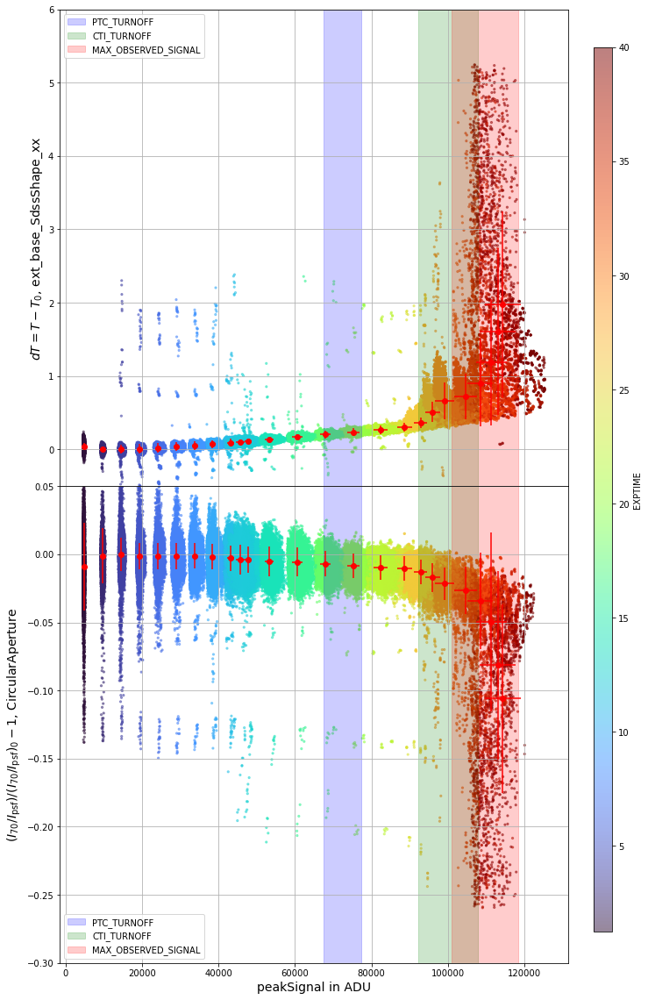

In [29]:
fig = plt.figure(figsize=(10,10),facecolor="white")

from astropy.table import vstack, join

y1key="base_SdssShape_xx"
y2key="base_SdssShape_yy"
#xkey="base_CircularApertureFlux_70_0_instFlux"
#xkey="base_CircularApertureFlux_70_0_instFlux"
xkey="peakSignal"
zskey="base_CircularApertureFlux_3_0_instFlux"
#zskey="base_PsfFlux_instFlux"
zlkey="base_CircularApertureFlux_70_0_instFlux"
# ext_shapeHSM_HsmSourceMoments_xx

badgain=1.3
x = []
y = []
zl = []
zs = []
e = []
for aresult in results[:]:
    thistable=aresult["src"]
    joined = join(aresult["src"],ref,keys="spotgrid_index")
    Iperr = joined["base_PsfFlux_instFluxErr_1"]
    Ip = joined["base_PsfFlux_instFlux_1"]    
#    Ierr = joined["{}Err_1".format(xkey)]
    I = joined["{}_1".format(xkey)]
    median=numpy.nanmedian(joined["base_CircularApertureFlux_70_0_instFlux_1"])
    joined = joined[
        numpy.where( 
            ((joined["spotgrid_x_1"]-joined["base_SdssCentroid_x_1"])**2+(joined["spotgrid_y_1"]-joined["base_SdssCentroid_y_1"])**2<2**2) &
            (joined["base_CircularApertureFlux_70_0_instFlux_1"]>numpy.nanmax(joined["base_CircularApertureFlux_70_0_instFlux_1"])*0.90) # trying to choose center spots
        )
    ]
    x.extend(joined["{}_1".format(xkey)])
    Y1=joined["{}_1".format(y1key)]
    Y2=joined["{}_1".format(y2key)]
    Y0_1=joined["{}_2".format(y1key)]
    Y0_2=joined["{}_2".format(y2key)]    
    zl.extend(joined["{}_1".format(zlkey)]/joined["{}_2".format(zlkey)])
    zs.extend(joined["{}_1".format(zskey)]/joined["{}_2".format(zskey)])
    y.extend( Y1+Y2-(Y0_1+Y0_2) )
    e.extend([aresult["md"]["EXPTIME"]]*len(Y1))
        
x=numpy.array(x)
y=numpy.array(y)
zl=numpy.array(zl)
zs=numpy.array(zs)

fig = plt.figure(figsize=(10,20),facecolor="white")

ax = plt.subplot(211)
sca=ax.scatter(x/badgain,y,c=e,s=5,cmap='turbo',alpha=0.5)
ax.set_ylabel("{}".format(f"$dT=T-T_0$, ext_{y1key}"),fontsize=fontsize)
#ax.set_xlim(1e5,1e7)
ax.set_ylim(-.5,6)
#ax.set_ylim(-.5,2)
ax.grid()

e=numpy.array(e)
for i, _exptime in enumerate(list(set(e))):
    cond = numpy.where(e==_exptime)
    print(len(cond[0]))
    plt.errorbar(
        numpy.nanmedian(x[cond])/badgain,
        numpy.nanmedian(y[cond]),
        xerr=numpy.nanstd(x[cond])/badgain,
        yerr=numpy.nanstd(y[cond]),
        fmt="o",
        color="red"
    )

bx = plt.subplot(212,sharex=ax)
z=zs/zl-1
scb=bx.scatter(x/badgain,z,c=e,s=5,cmap='turbo',alpha=0.5)

for i, _exptime in enumerate(list(set(e))):
    cond = numpy.where(e==_exptime)
    plt.errorbar(
        numpy.nanmedian(x[cond])/badgain,
        numpy.nanmedian(z[cond]),
        xerr=numpy.nanstd(x[cond])/badgain,
        yerr=numpy.nanstd(z[cond]),
        fmt="o",
        color="red"
    )
bx.set_ylabel("{}".format(r"$(I_{70}/I_{\rm psf})/(I_{70}/I_{\rm psf})_0-1$, CircularAperture"),fontsize=fontsize)
#bx.set_xlim(1e5,0.55e7)
bx.set_ylim(-.3,.05)
#plt.semilogx()
bx.grid()
bx.set_xlabel(f"{xkey} in ADU",fontsize=fontsize)

for axis in [ ax, bx ]:
    for color, vlabel in [ 
        ("b", "PTC_TURNOFF"),        
        ("g", "CTI_TURNOFF") 
        ]:
        axis.axvspan((subdf[vlabel]).min(),
                   (subdf[vlabel]).max(),
                   label=vlabel,alpha=0.2,color=color)

    axis.axvspan(100943.95,118322.14, label="MAX_OBSERVED_SIGNAL",alpha=0.2,color="red")
    axis.legend()

#plt.colorbar(scb,label="EXPTIME",orientation="horizontal",location="bottom")
cbar_ax = fig.add_axes([0.97, 0.15, 0.03, 0.7])
plt.colorbar(scb,cax=cbar_ax,label="EXPTIME")

plt.subplots_adjust(right=0.93,hspace=0)

(array([400, 401, 402, 403, 404, 405, 406, 407, 408, 409, 410, 411, 412,
       413, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425,
       426, 427, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438,
       439, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451,
       452, 453, 454, 455, 456, 457, 458, 459, 460, 461, 462, 463, 464,
       465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 476, 477,
       478, 479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490,
       491, 492, 493, 494, 495, 496, 497, 498, 499, 500, 501, 502, 503,
       504, 505, 506, 507, 508, 509, 510, 511, 512, 513, 514, 515, 516,
       517, 518, 519, 520, 521, 522, 523, 524, 525, 526, 527, 528, 529,
       530, 531, 532, 533, 534, 535, 536, 537, 538, 539, 540, 541, 542,
       543, 544, 545, 546, 547, 548, 549, 550, 551, 552, 553, 554, 555,
       556, 557, 558, 559, 560, 561, 562, 563, 564, 565, 566, 567, 568,
       569, 570, 571, 572, 573, 574, 575, 576, 577, 578, 579, 5

Text(0.5, 0, 'EXPTIME [s]')

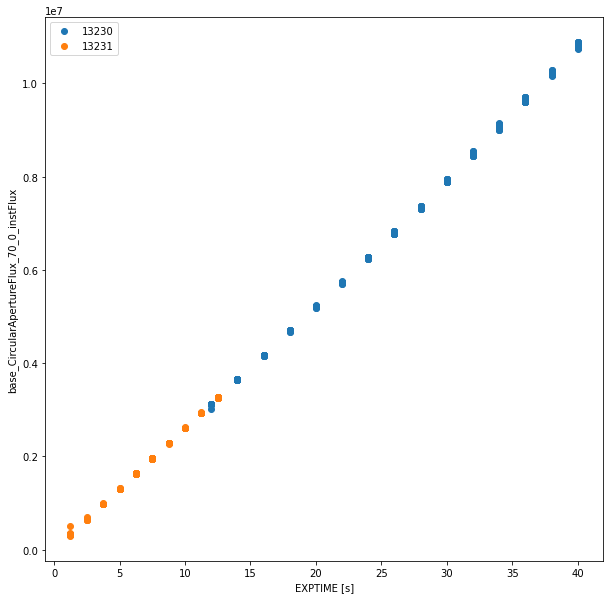

In [20]:
import pylab
fig = plt.figure(figsize=(10,10))

#for a in faint:
peak = []
exp = []
run = []
for b in results:
    peak.append(numpy.nanmax(b["src"]["base_CircularApertureFlux_70_0_instFlux"]))
    exp.append(b["md"]["EXPTIME"])
    run.append(b["md"]["RUNNUM"])

exp=numpy.array(exp)
peak=numpy.array(peak)
run=numpy.array(run)
for arun in list(set(run)):
    print(numpy.where(run == arun))
    pylab.plot(exp[numpy.where(run == arun)],peak[numpy.where(run == arun)],"o",label=arun)
exp.sort()
print(exp)
pylab.legend()
pylab.ylabel("base_CircularApertureFlux_70_0_instFlux")
pylab.xlabel("EXPTIME [s]")

base_SdssShape_xx: 0.4151333235858053
base_SdssShape_xy: 0.163148656204939
base_SdssShape_yy: 0.8290509986224169


/tmp/ipykernel_62855/1143856788.py:89: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  src["base_SdssCentroid_x"]-src["base_SdssCentroid_x"].astype(numpy.int),
/tmp/ipykernel_62855/1143856788.py:90: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additiona

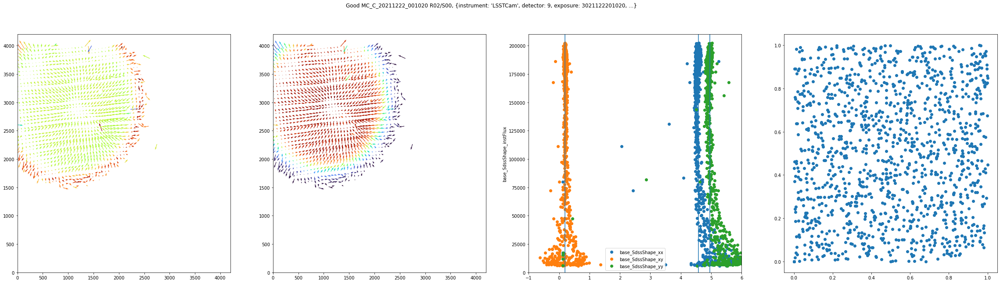

base_SdssShape_xx: 0.4464024492622454
base_SdssShape_xy: 0.1634642532927289
base_SdssShape_yy: 0.43421845534555015


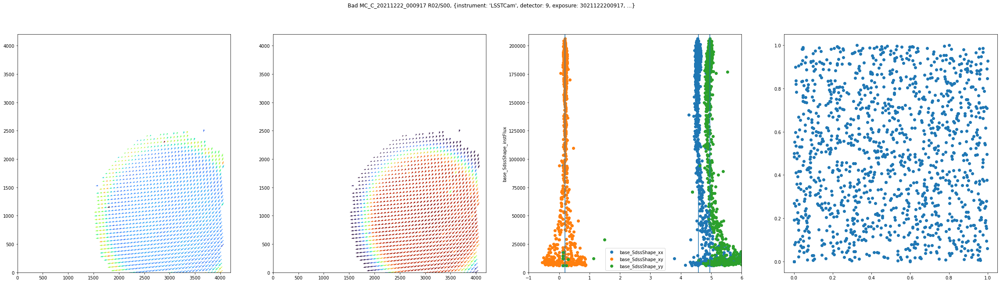

base_SdssShape_xx: 0.44803699846903955
base_SdssShape_xy: 0.17626424827411577
base_SdssShape_yy: 0.44340406981191915


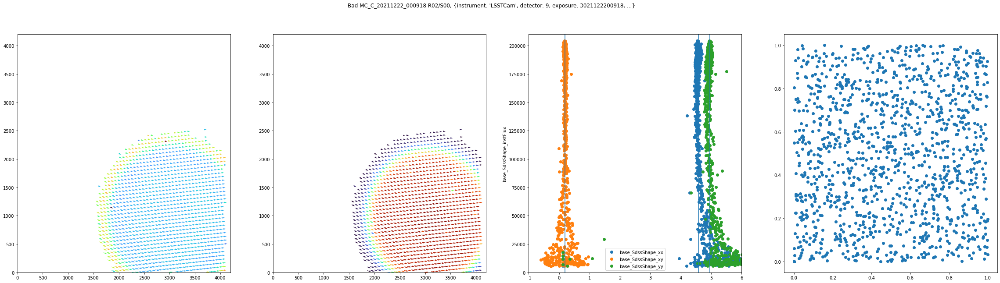

base_SdssShape_xx: 0.44267793612449935
base_SdssShape_xy: 0.17883785514520742
base_SdssShape_yy: 0.47725107897844193


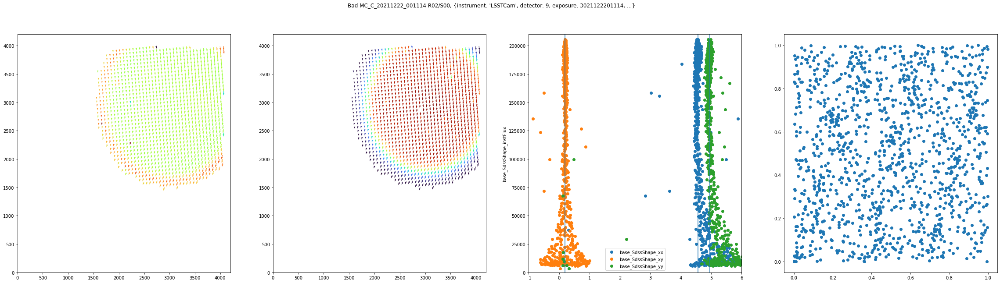

base_SdssShape_xx: 0.4494476543777636
base_SdssShape_xy: 0.16144076876452826
base_SdssShape_yy: 0.43702381472366286


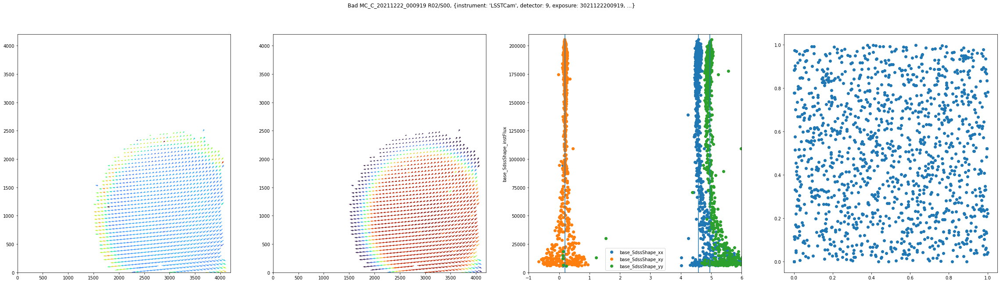

base_SdssShape_xx: 0.4348055096766013
base_SdssShape_xy: 0.16849063916652884
base_SdssShape_yy: 0.7786702073487645


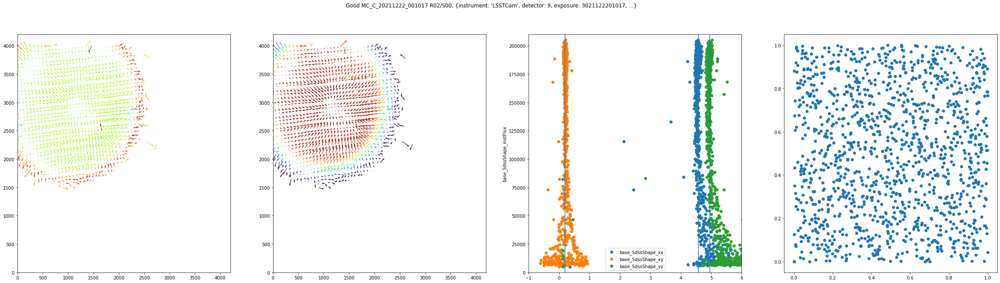

base_SdssShape_xx: 0.4731643789430382
base_SdssShape_xy: 0.1623189564651446
base_SdssShape_yy: 0.453782188832545


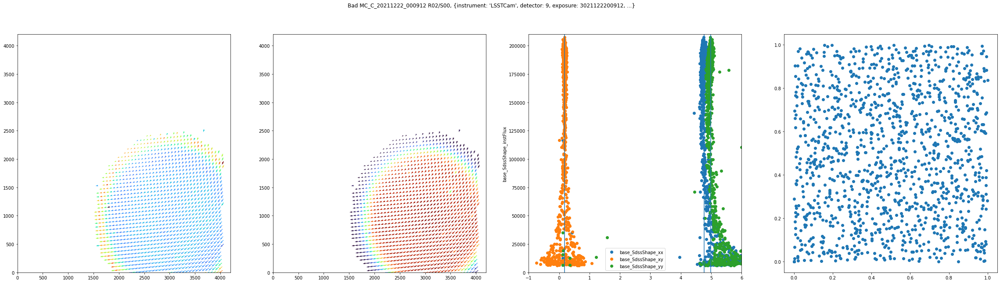

base_SdssShape_xx: 0.4906285956264175
base_SdssShape_xy: 0.2118569880188602
base_SdssShape_yy: 0.5421586838512072


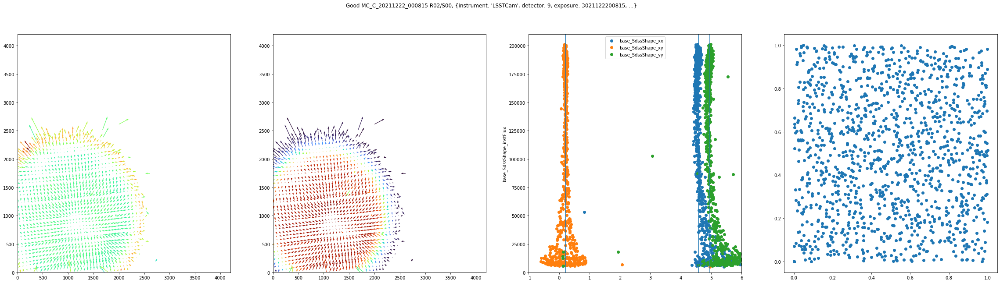

base_SdssShape_xx: 0.46808486748983136
base_SdssShape_xy: 0.17555241314677875
base_SdssShape_yy: 0.50803819553691


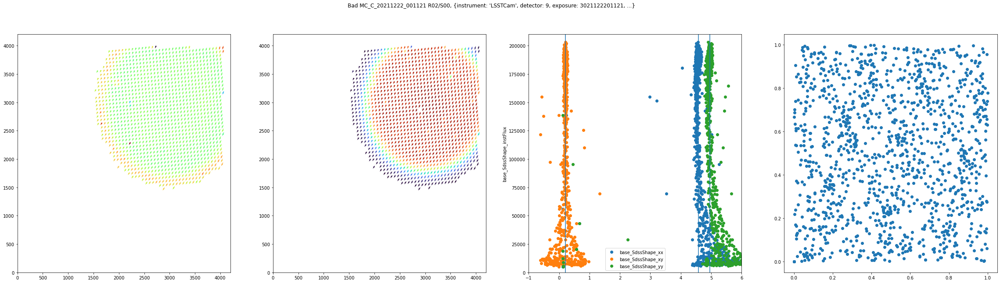

base_SdssShape_xx: 0.5249509090869188
base_SdssShape_xy: 0.21876667149714052
base_SdssShape_yy: 0.5576996510633189


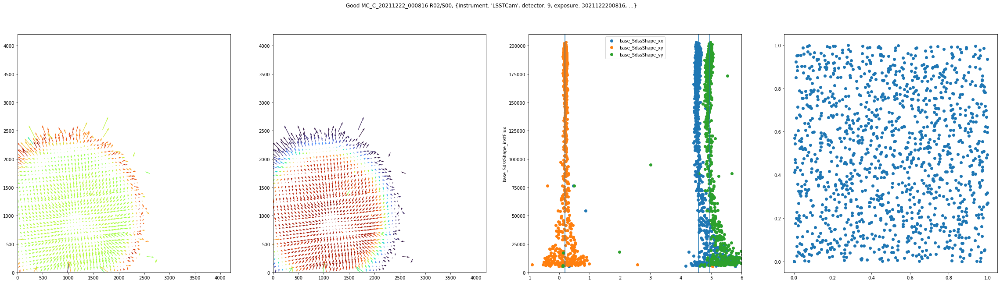

base_SdssShape_xx: 0.43271442633028495
base_SdssShape_xy: 0.19357620014285626
base_SdssShape_yy: 0.7869196547887668


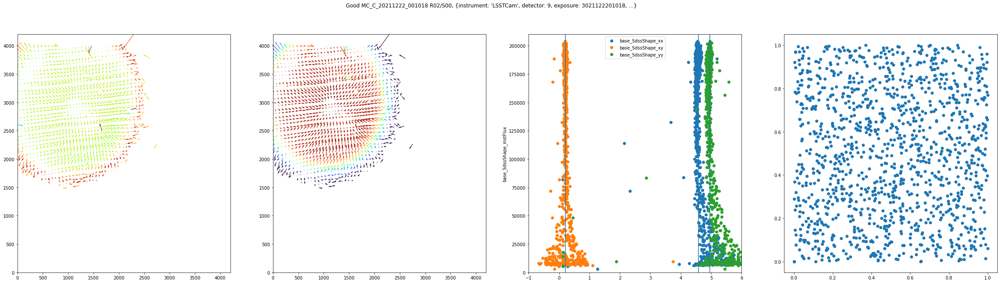

base_SdssShape_xx: 0.4405827387963196
base_SdssShape_xy: 0.17437421847242926
base_SdssShape_yy: 0.47462701017457587


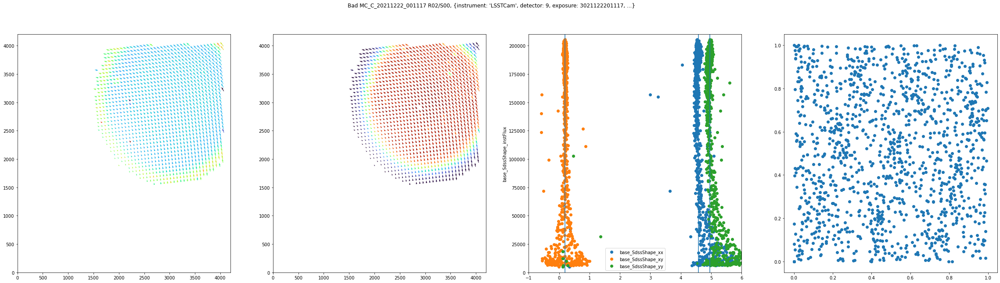

base_SdssShape_xx: 0.4876086218690268
base_SdssShape_xy: 0.16702598817706163
base_SdssShape_yy: 0.7792424914309097


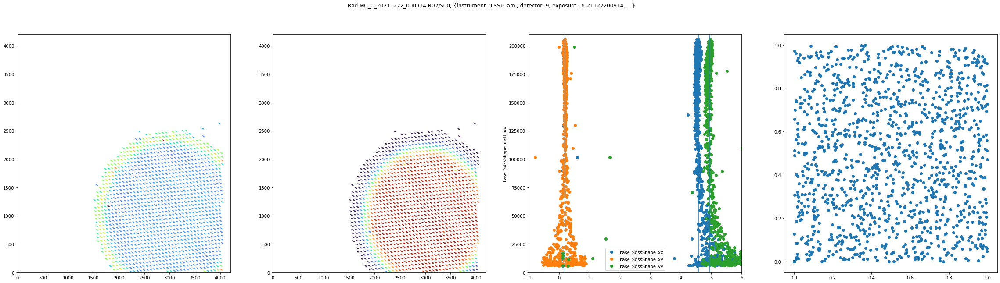

base_SdssShape_xx: 0.4094462566368645
base_SdssShape_xy: 0.1651088164754367
base_SdssShape_yy: 0.7626102110022016


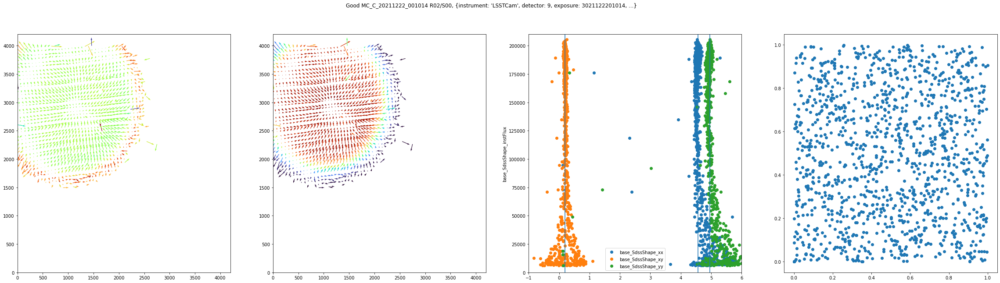

base_SdssShape_xx: 0.3943197205668451
base_SdssShape_xy: 0.19752759209985152
base_SdssShape_yy: 0.41649657977965165


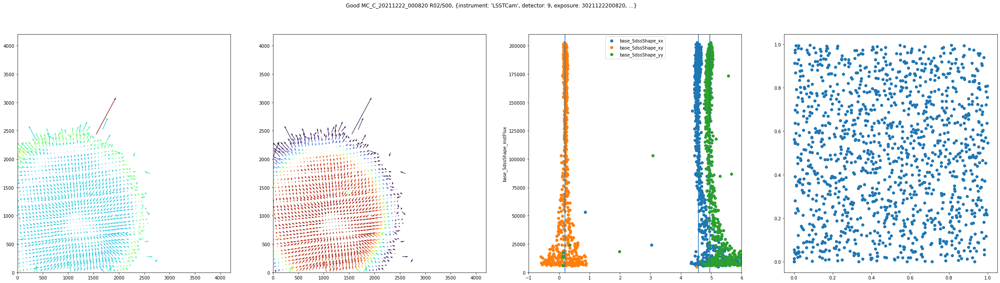

base_SdssShape_xx: 0.5144293269261662
base_SdssShape_xy: 0.40854957956106586
base_SdssShape_yy: 0.45896529493798655


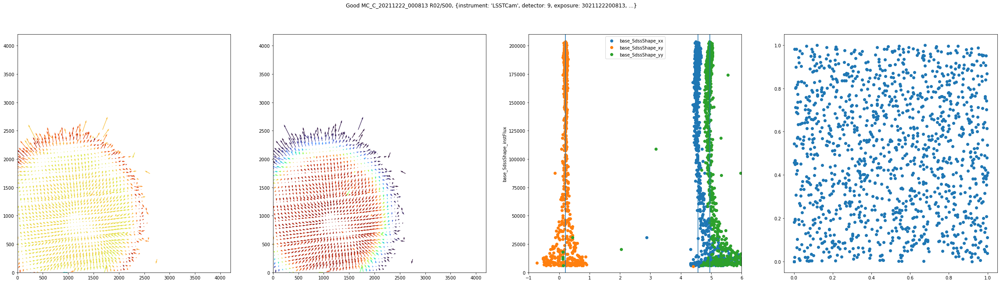

base_SdssShape_xx: 0.5442630905779084
base_SdssShape_xy: 0.22400438278009963
base_SdssShape_yy: 0.5901413127982579


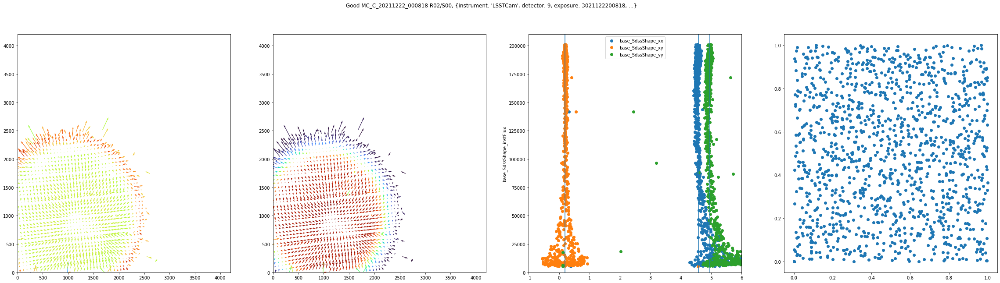

base_SdssShape_xx: 0.4171561373301147
base_SdssShape_xy: 0.17581151208930623
base_SdssShape_yy: 0.4176598898165626


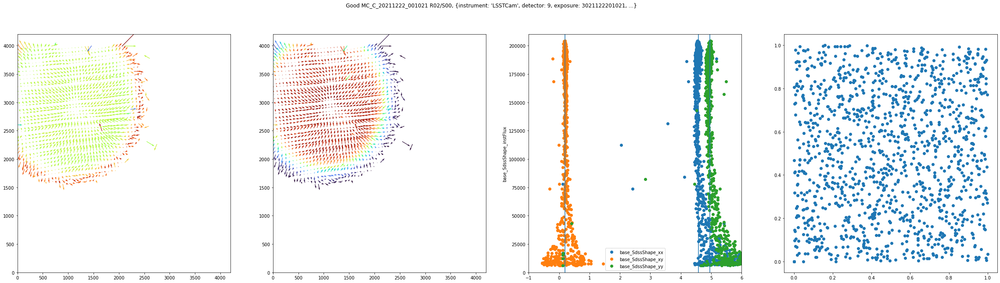

base_SdssShape_xx: 0.4510492010377891
base_SdssShape_xy: 0.17899467508255154
base_SdssShape_yy: 0.4626366666596921


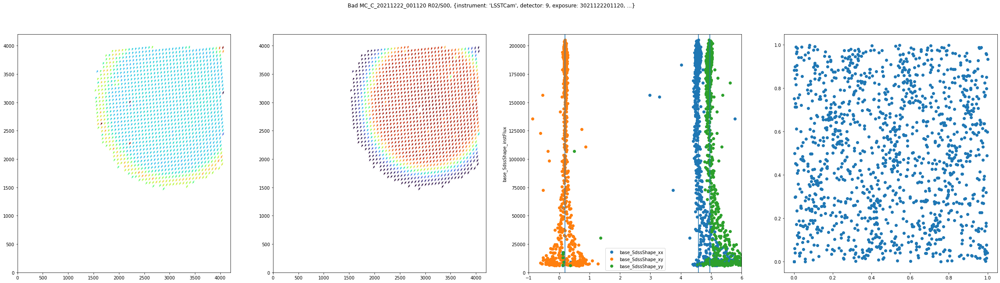

base_SdssShape_xx: 0.41622090921287686
base_SdssShape_xy: 0.1626768531550895
base_SdssShape_yy: 0.4564876942111452


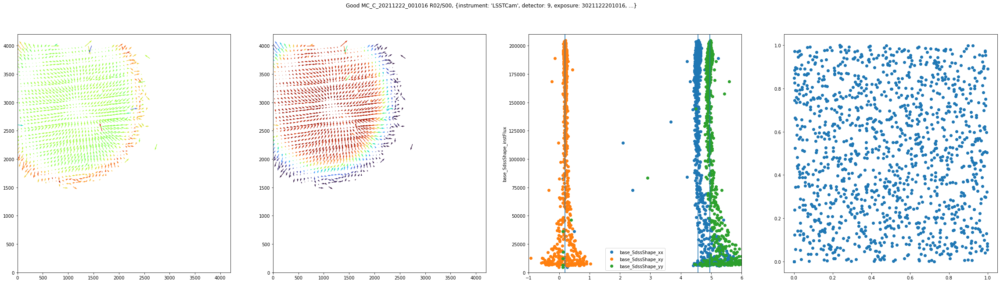

base_SdssShape_xx: 0.505549855904575
base_SdssShape_xy: 0.19588909722090408
base_SdssShape_yy: 0.5045227576441385


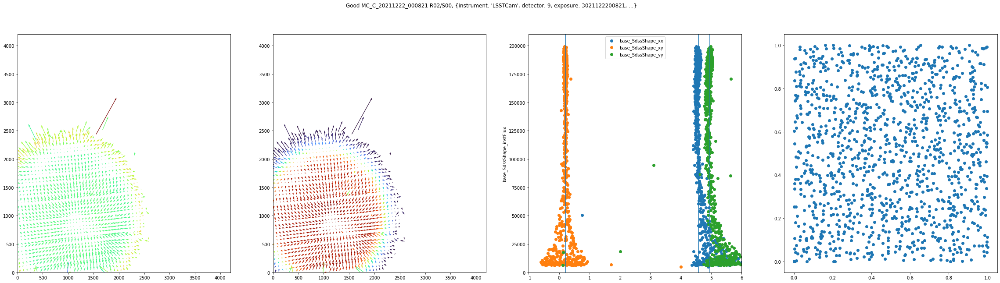

base_SdssShape_xx: 0.3990031459817448
base_SdssShape_xy: 0.16952154356499696
base_SdssShape_yy: 0.42152515064025925


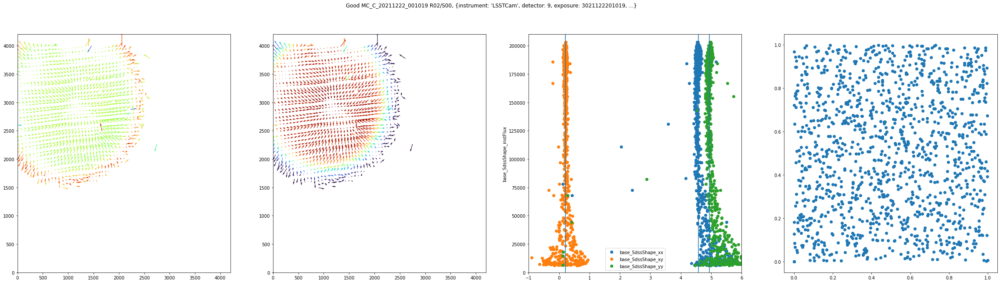

base_SdssShape_xx: 0.49152649418925376
base_SdssShape_xy: 0.6851129288761276
base_SdssShape_yy: 1.4087130223130604


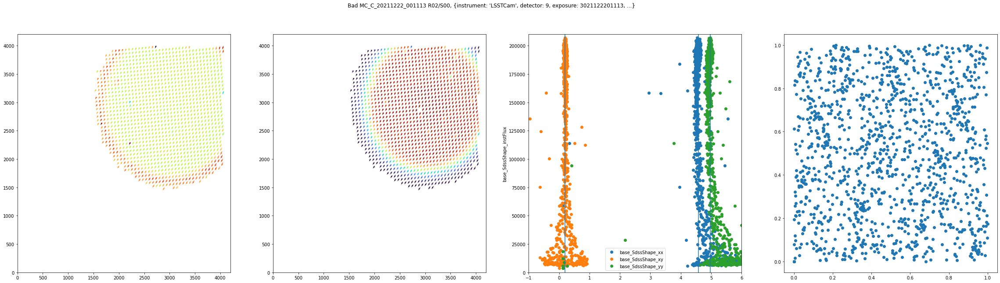

base_SdssShape_xx: 0.4448056815554781
base_SdssShape_xy: 0.1756560093298505
base_SdssShape_yy: 0.47107973629538896


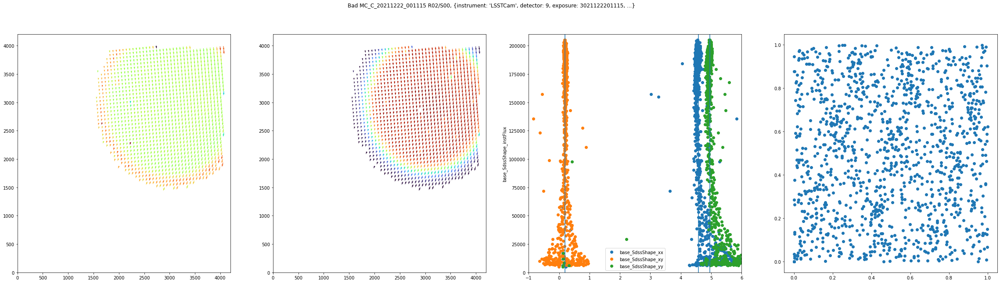

base_SdssShape_xx: 0.45200713072996523
base_SdssShape_xy: 0.17409757872225073
base_SdssShape_yy: 0.4410100923290199


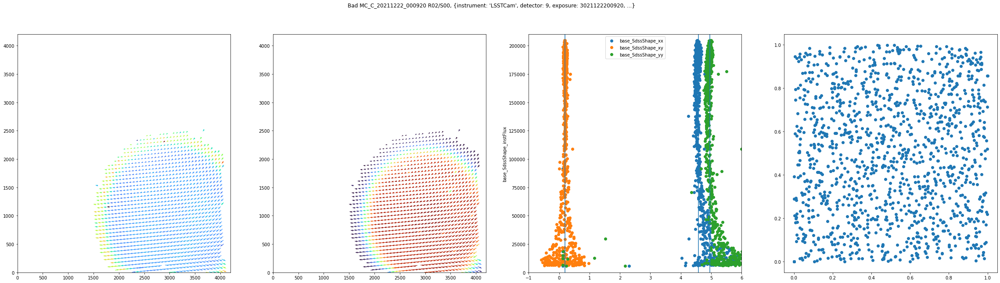

base_SdssShape_xx: 0.4687937205931377
base_SdssShape_xy: 0.16458074203770376
base_SdssShape_yy: 0.46038596761374534


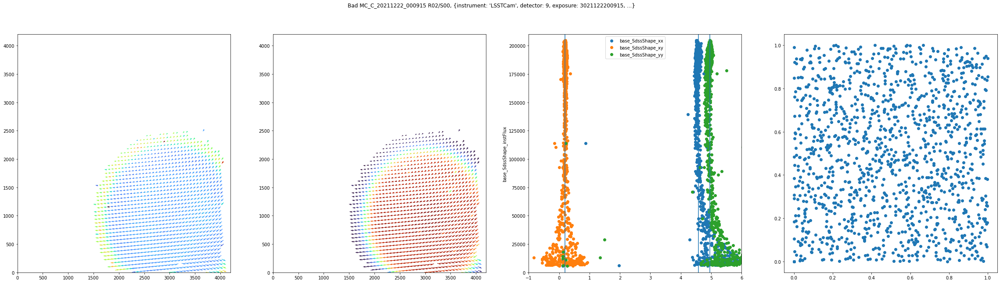

base_SdssShape_xx: 0.48431642516393947
base_SdssShape_xy: 0.1989023481544999
base_SdssShape_yy: 0.4834806299966416


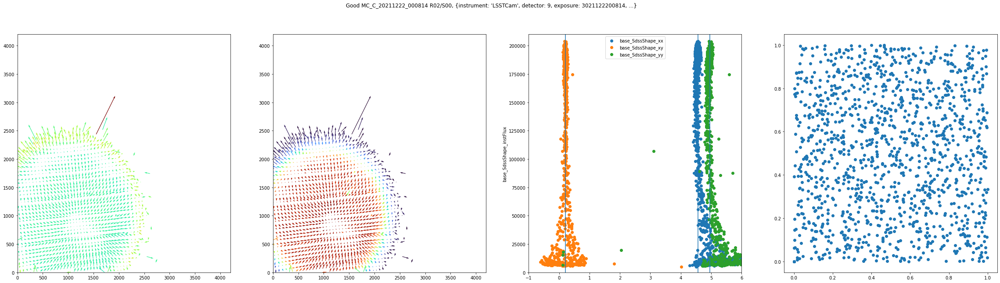

base_SdssShape_xx: 0.5251816809563982
base_SdssShape_xy: 0.19671427921135085
base_SdssShape_yy: 0.5433525084209995


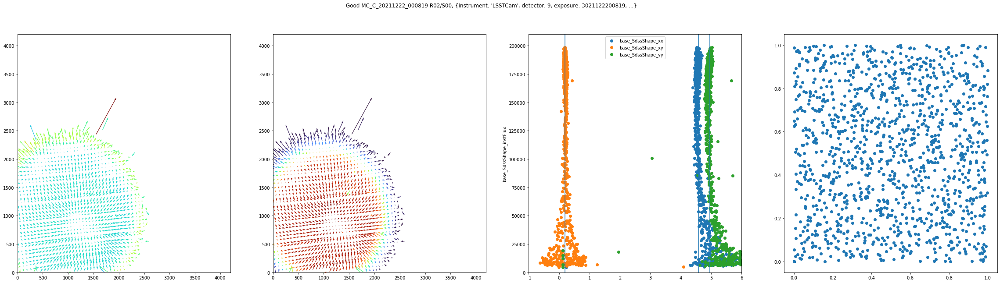

base_SdssShape_xx: 0.46637922706771706
base_SdssShape_xy: 0.165357995161527
base_SdssShape_yy: 0.4510368665545903


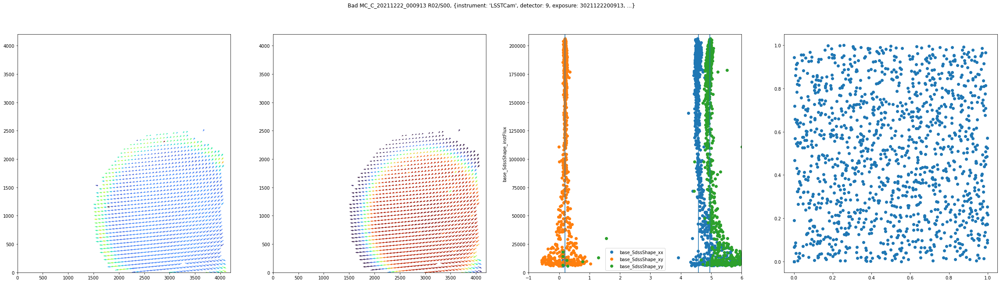

base_SdssShape_xx: 0.4317011688093496
base_SdssShape_xy: 0.1871484406926395
base_SdssShape_yy: 0.4408587054751437


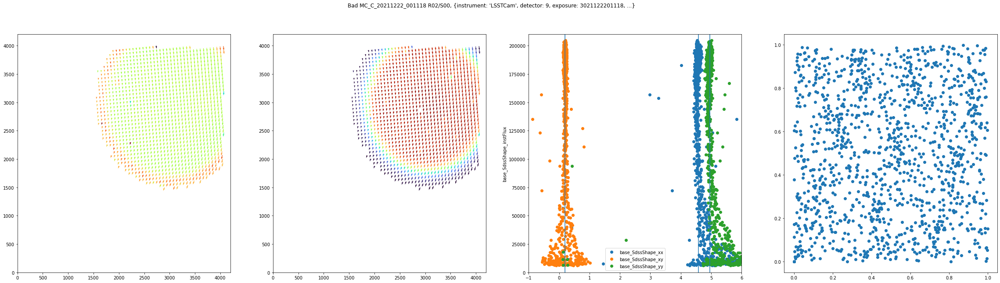

base_SdssShape_xx: 0.4439608024968043
base_SdssShape_xy: 0.16781898127137979
base_SdssShape_yy: 0.4336130604023526


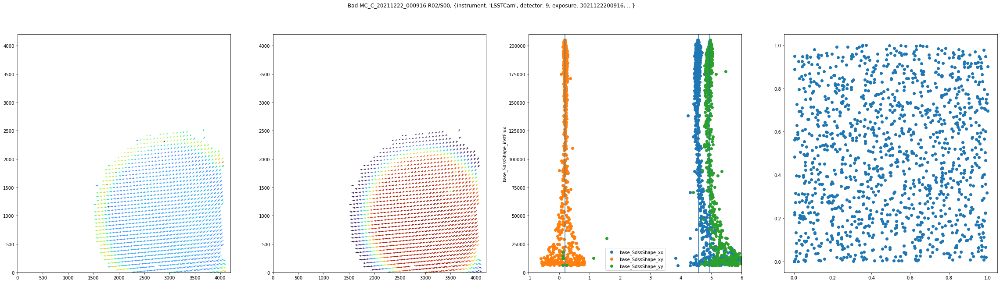

base_SdssShape_xx: 0.4654806619741968
base_SdssShape_xy: 0.14631498940293253
base_SdssShape_yy: 0.4794377726401737


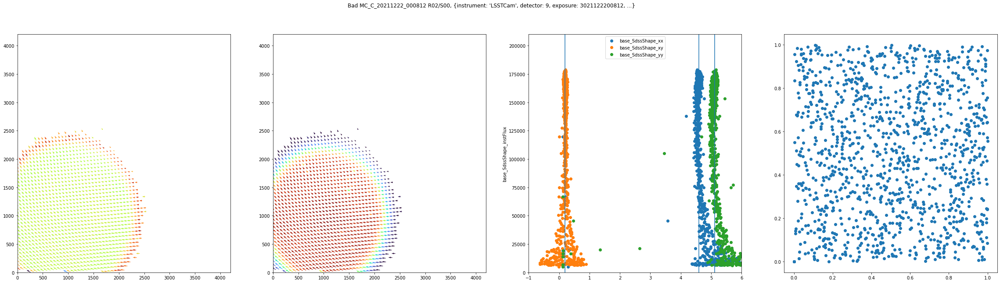

base_SdssShape_xx: 0.44251051647022316
base_SdssShape_xy: 0.17889685180749496
base_SdssShape_yy: 0.4350037382307732


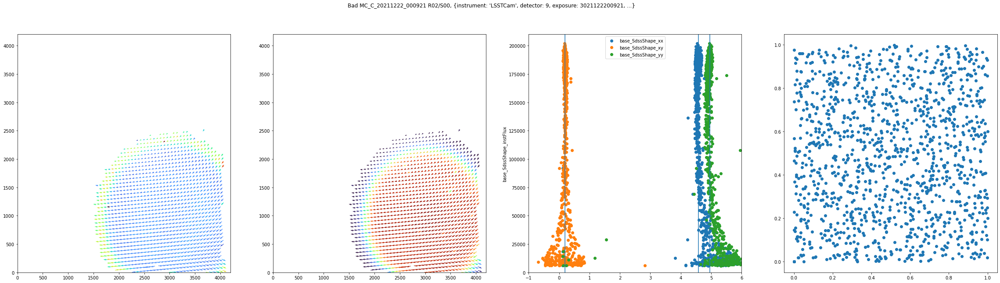

base_SdssShape_xx: 0.436509350738071
base_SdssShape_xy: 0.1634750593397179
base_SdssShape_yy: 0.7835653501418652


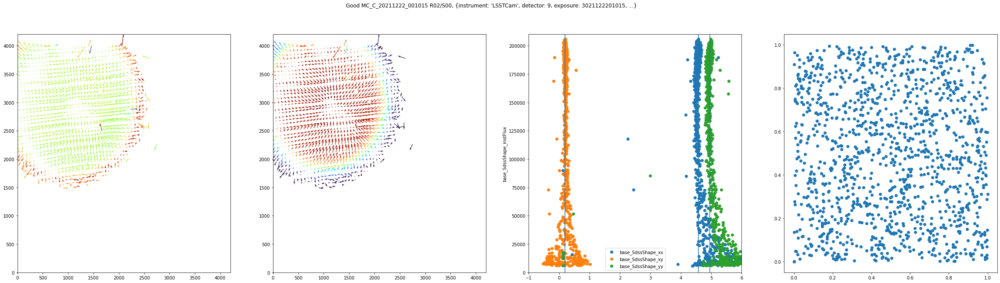

base_SdssShape_xx: 0.45382220840490073
base_SdssShape_xy: 0.16366305709354997
base_SdssShape_yy: 0.5218632507303113


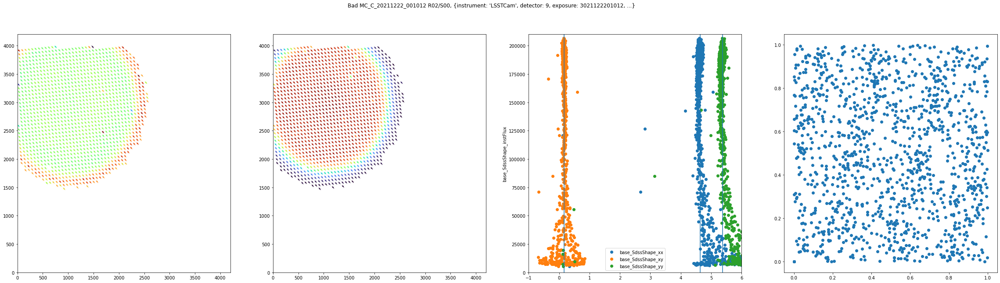

base_SdssShape_xx: 0.5072305061534903
base_SdssShape_xy: 0.20358518360694297
base_SdssShape_yy: 0.5298766813679036


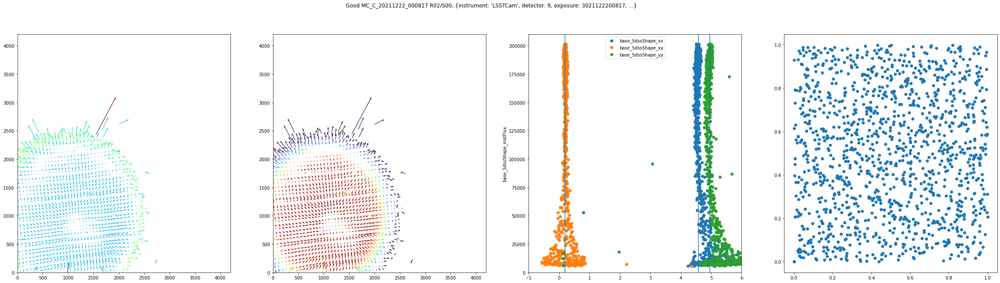

base_SdssShape_xx: 0.43936768001531085
base_SdssShape_xy: 0.174113954844311
base_SdssShape_yy: 0.4722631483792673


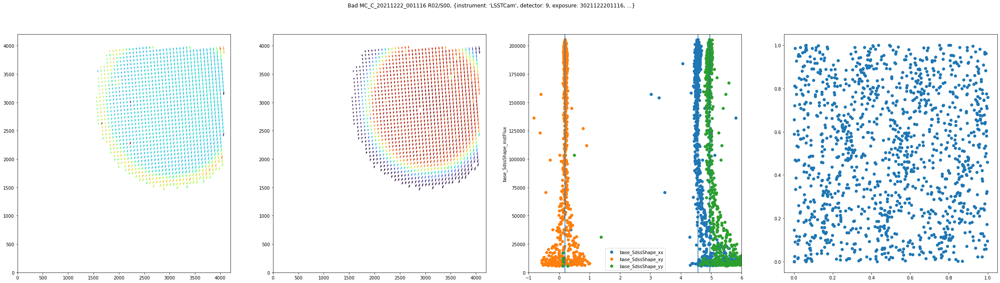

base_SdssShape_xx: 0.4274820323876912
base_SdssShape_xy: 0.1749119102141291
base_SdssShape_yy: 0.47241894389262773


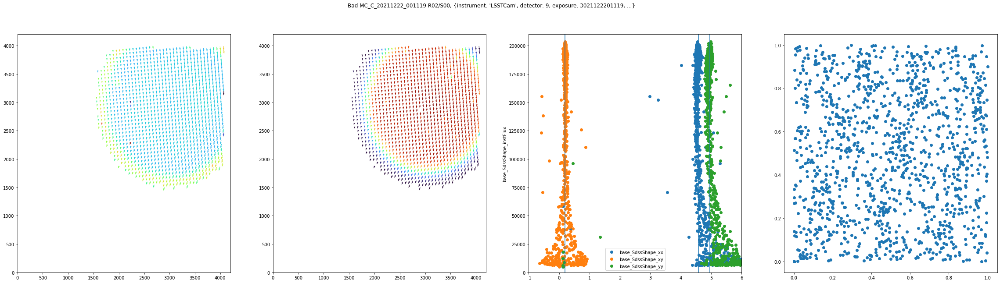

base_SdssShape_xx: 0.49554230615173517
base_SdssShape_xy: 0.17658474884582456
base_SdssShape_yy: 0.7466688503244551


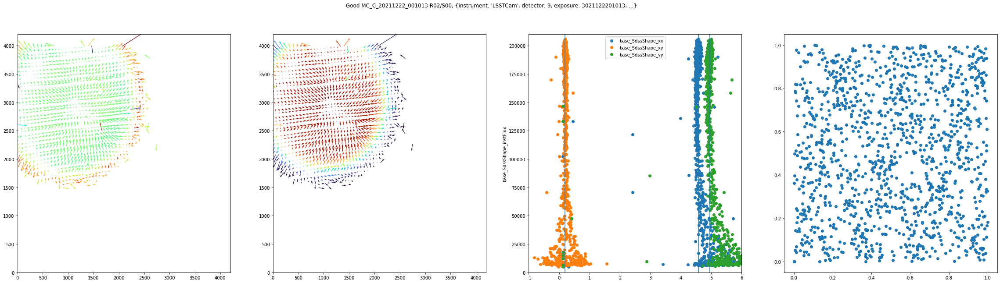

base_SdssShape_xx: 0.6563635003940386
base_SdssShape_xy: 0.2774754776091865
base_SdssShape_yy: 0.4965821429853504


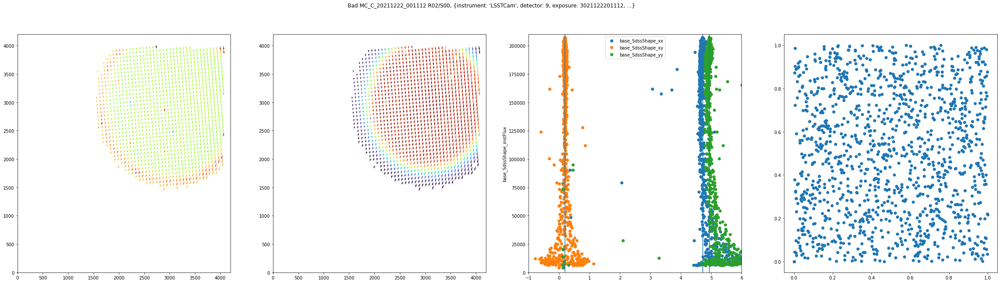

In [207]:
where = """
instrument='LSSTCam'
and detector=9
and exposure.observation_type = 'spot'
and exposure.exposure_time = 1.25
and exposure.science_program IN ('13231')
"""
#-- and exposure.exposure_time 1.25

# gridSpotSrc

datasetRefs = list(subregistry.queryDatasets(
    datasetType="postISRCCD",
    collections=collections,
    where=where)
                  )
subresults = []

for aref in datasetRefs[::]:
    try:
        # get a catalog from the butler
        raw = subbutler.get(aref)
        # get the associated metadata from raw data which contains EXPTIME
        src = subbutler.get("gridSpotSrc",dataId=aref.dataId)
#        src = subbutler.get("spotSrc",dataId=aref.dataId)
        img = raw.getImage().getArray()
#        print(src.asAstropy()["base_SdssCentroid_x","base_SdssCentroid_y","base_SdssShape_instFlux"])
        md = raw.getMetadata()
        x=src["spotgrid_x"]
        y=src["spotgrid_y"]
        I=src["base_SdssShape_instFlux"]
        T=src["base_SdssShape_xx"]+src["base_SdssShape_yy"]
    
        fig, axs = pylab.subplots(1, 4, figsize=(40,10),facecolor='w')

#        axs[0].plot(x,y,"o",alpha=0.5)        
#        axs[0].imshow(img,origin="lower",vmin=-0.5*img.std(),vmax=0.5*img.std())
        isgood="Good" if numpy.nanmean((src["base_SdssCentroid_x"] - src["spotgrid_x"])**2+(src["base_SdssCentroid_y"] - src["spotgrid_y"])**2)<2**2 else "Bad"

        pylab.suptitle(f"{isgood} {md['OBSID']} {md['RAFTBAY']}/{md['CCDSLOT']}, {aref.dataId}")
#        axs[0].scatter(x,y,fmt="o",alpha=0.5)                
#        axs[0].scatter(x,y,c=I/numpy.nanmax(I),s=5,cmap='turbo',alpha=1)
        axs[0].quiver(
            src["base_SdssCentroid_x"],
            src["base_SdssCentroid_y"],
            src["spotgrid_x"]-src["base_SdssCentroid_x"],
            src["spotgrid_y"]-src["base_SdssCentroid_y"],
            T/numpy.nanmax(T),
            units="xy",
            angles="xy",
            cmap='turbo'
        )
        axs[0].set_xlim(0,4200)
        axs[0].set_ylim(0,4200)

        axs[1].quiver(
            src["base_SdssCentroid_x"],
            src["base_SdssCentroid_y"],
            src["spotgrid_x"]-src["base_SdssCentroid_x"],
            src["spotgrid_y"]-src["base_SdssCentroid_y"],
            I/numpy.nanmax(I),
            units="xy",
            angles="xy",
            cmap='turbo'
        )
        axs[1].set_xlim(0,4200)
        axs[1].set_ylim(0,4200)

        for xkey in [
            "base_SdssShape_xx",
            "base_SdssShape_xy",
            "base_SdssShape_yy"          
        ]:
            median = numpy.nanmedian(src[xkey])
            axs[2].scatter(
                src[xkey],
                src["base_SdssShape_instFlux"],
                label=xkey
            )
            axs[2].axvline(numpy.nanmedian(src[xkey]))
            print(f"{xkey}: {numpy.nanstd(src[xkey])}")
            axs[2].legend()
        axs[2].set_xlim(-1,6)
        axs[2].set_ylim(0,210000)
        axs[2].set_ylabel("base_SdssShape_instFlux")
        
#        axs[3].scatter(src["base_SdssCentroid_xErr"],src["base_SdssCentroid_yErr"])
        axs[3].scatter(
            src["base_SdssCentroid_x"]-src["base_SdssCentroid_x"].astype(numpy.int),
            src["base_SdssCentroid_y"]-src["base_SdssCentroid_y"].astype(numpy.int)
        )
#        axs[3].set_xlim(0,0.2)
#        axs[3].set_ylim(0,0.2)        

        
        pylab.show()
        subresults.append( {"md": md, "src":src} )
    except:
        raise
#        pass


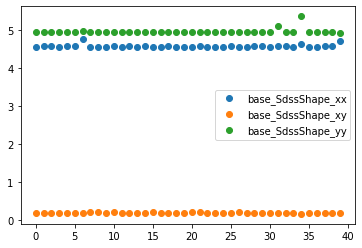

In [152]:
for akey in [
    "base_SdssShape_xx",
    "base_SdssShape_xy",
    "base_SdssShape_yy"
    ]:
    pylab.plot(
        [ numpy.nanmedian(asubresult["src"][akey]) for asubresult in subresults ],
        "o",label=akey)
pylab.legend()


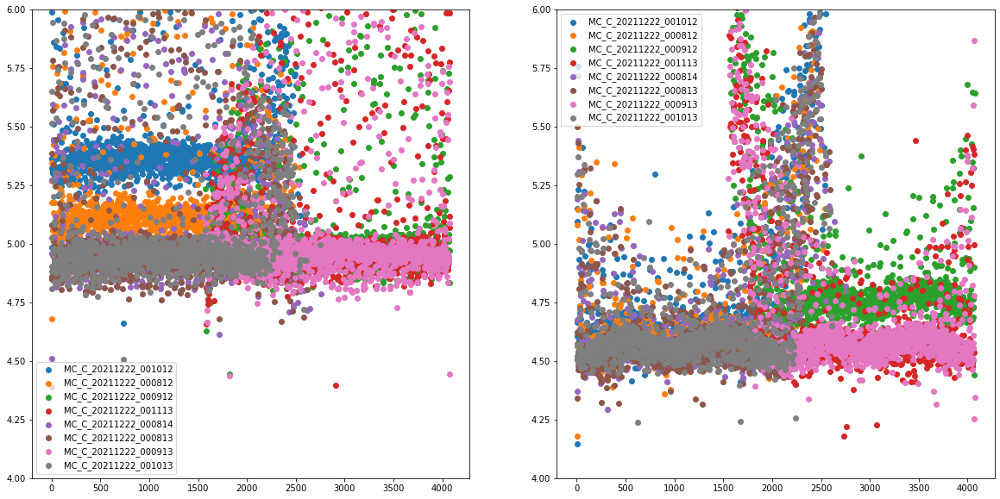

(4.5, 6.0)

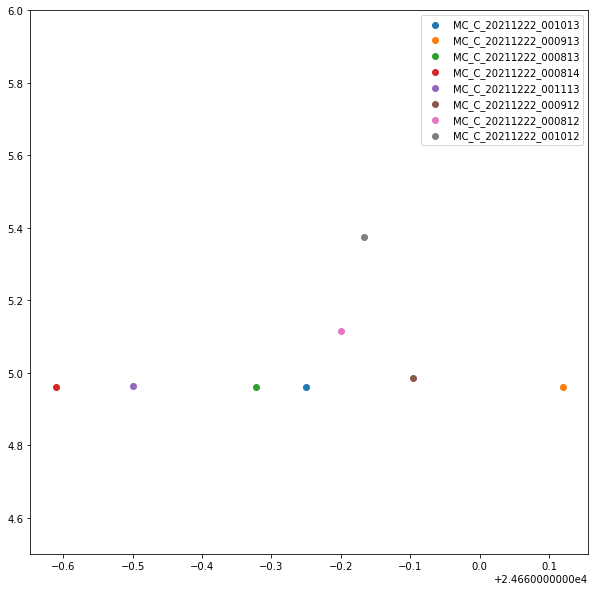

In [230]:
idx=numpy.argsort([ numpy.nanmedian(asubresult["src"]["base_SdssShape_yy"]) for asubresult in subresults ])

fig, axs = pylab.subplots(1, 2, figsize=(20,10),facecolor='w')
for i in idx[-8:][::-1]:
    asubresult=subresults[i]
    axs[0].scatter(
        asubresult["src"]["base_SdssCentroid_x"],
        asubresult["src"]["base_SdssShape_yy"],
        label=asubresult["md"]["OBSID"]
    )
    axs[0].legend()
    axs[0].set_ylim(4.0,6.)
    axs[1].scatter(
        asubresult["src"]["base_SdssCentroid_x"],
        asubresult["src"]["base_SdssShape_xx"],
        label=asubresult["md"]["OBSID"]
    )
    axs[1].legend()
    axs[1].set_ylim(4.0,6.0)


pylab.show()
fig, axs = pylab.subplots(1, 1, figsize=(10,10),facecolor='w')
for i in idx[-8:]:
    asubresult=subresults[i]
    pylab.scatter(
        asubresult["md"]["ISR_OSCAN_LEVELC10"],
#        asubresult["md"]["BOTYCAM"],
        numpy.median(asubresult["src"]["base_SdssShape_yy"]),
        label=asubresult["md"]["OBSID"]
    )
pylab.legend()
pylab.ylim(4.5,6)

Text(0.5, 0, 'MJD')

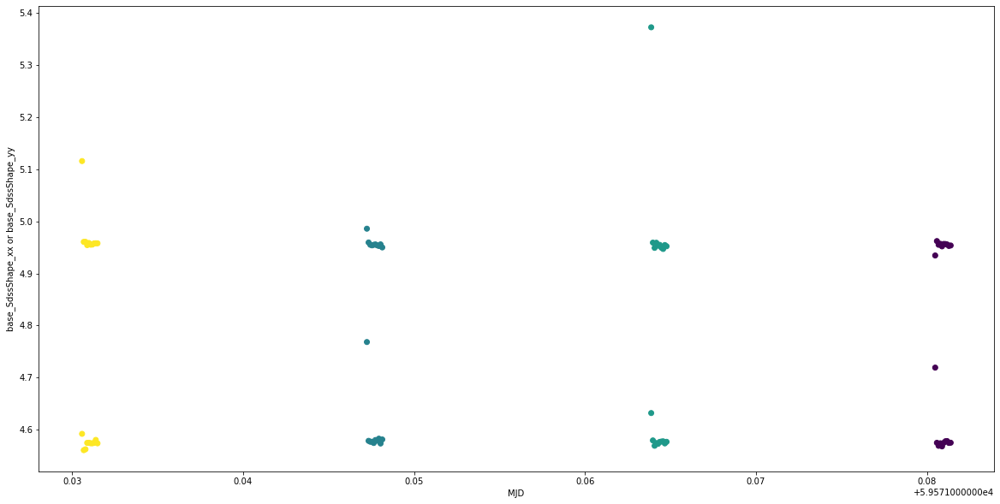

In [222]:
fig, axs = pylab.subplots(1, 1, figsize=(20,10),facecolor='w')

for akey in ["base_SdssShape_xx", "base_SdssShape_yy"]:
    pylab.scatter(
        [ asubresult["md"]["MJD"] for asubresult in subresults ],
        [ numpy.nanmedian(asubresult["src"][akey]) for asubresult in subresults ],
        c=[ asubresult["md"]["BOTX"]*asubresult["md"]["BOTY"] for asubresult in subresults ]
    )
pylab.ylabel("base_SdssShape_xx or base_SdssShape_yy")
pylab.xlabel("MJD")

Text(0.5, 0, 'MJD')

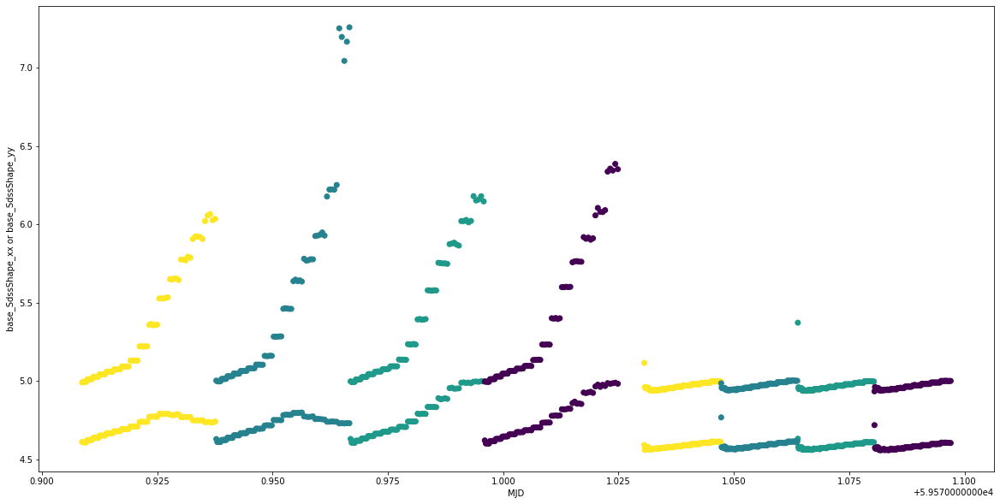

In [228]:
fig, axs = pylab.subplots(1, 1, figsize=(20,10),facecolor='w')

for akey in ["base_SdssShape_xx", "base_SdssShape_yy"]:
    pylab.scatter(
        [ asubresult["md"]["MJD"] for asubresult in results ],
        [ numpy.nanmedian(asubresult["src"][akey]) for asubresult in results ],
        c=[ asubresult["md"]["BOTX"]*asubresult["md"]["BOTY"] for asubresult in results ]
    )
pylab.ylabel("base_SdssShape_xx or base_SdssShape_yy")
pylab.xlabel("MJD")

Text(0, 0.5, 'base_SdssShape_xx, base_SdssShape_yy')

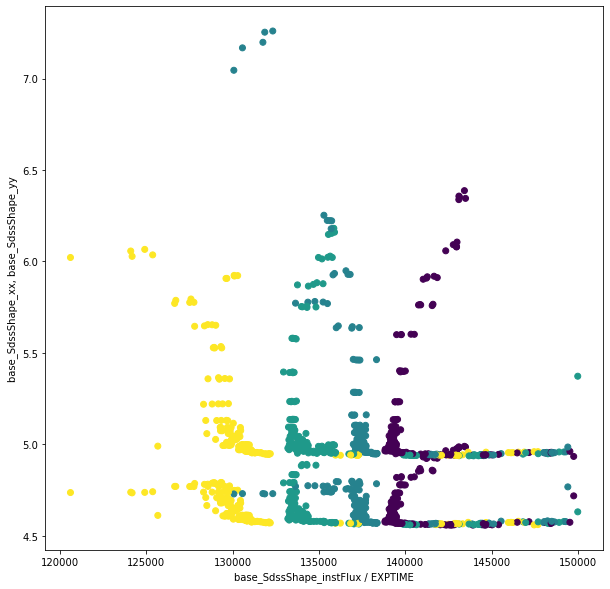

In [237]:
fig, axs = pylab.subplots(1, 1, figsize=(10,10),facecolor='w')

for akey in ["base_SdssShape_xx", "base_SdssShape_yy"]:
    pylab.scatter(
        [ numpy.nanmedian(asubresult["src"]["base_SdssShape_instFlux"])/asubresult["md"]["EXPTIME"] for asubresult in results ],
        [ numpy.nanmedian(asubresult["src"][akey]) for asubresult in results ],        
        c=[ asubresult["md"]["BOTX"]*asubresult["md"]["BOTY"] for asubresult in results ]
    )
pylab.xlabel("base_SdssShape_instFlux / EXPTIME")
pylab.ylabel("base_SdssShape_xx, base_SdssShape_yy")

In [238]:
asubresult["md"].toOrderedDict()

{'DATE': '2021-12-23T01:31:58.739',
 'MJD': 59571.0638742941,
 'RUNNUM': '13231',
 'CCD_MANU': 'ITL',
 'CCD_TYPE': '3800C',
 'TESTTYPE': 'SPOT_FLAT',
 'IMGTYPE': 'SPOT',
 'BINX': 1,
 'BINY': 1,
 'CCDGAIN': 1.0,
 'CCDNOISE': 10.0,
 'DATE-TRG': '2021-12-23T01:31:58.734',
 'MJD-TRG': 59571.0638742363,
 'IMAGETAG': 'e58ce0de2cb94646',
 'CCDSLOT': 'S00',
 'RAFTBAY': 'R02',
 'FIRMWARE': '31395007',
 'PLATFORM': 'ir2-camera',
 'CONTNUM': '189223f9',
 'DAQVERS': 'R5-V0.11 2021-11-03T15:13:45Z (fbaf2dd)',
 'DAQPART': 'camera',
 'DAQFOLD': 'raw',
 'DAQANNOT': '450nm',
 'OBSID': 'MC_C_20211222_001012',
 'TELCODE': 'MC',
 'CONTRLLR': 'C',
 'DAYOBS': '20211222',
 'SEQNUM': 1012,
 'HEADVER': 2,
 'INSTRUME': 'lsstCam',
 'TELESCOP': 'LSST',
 'TSTAND': 'BOT',
 'SEQFILE': 'FP_ITL_2s_ir2_v26.seq',
 'SEQCKSUM': '980618532',
 'LSST_NUM': 'ITL-3800C-269',
 'CCD_SERN': '23014',
 'REBNAME': 'LCA-13574-019',
 'RAFTNAME': 'LCA-11021_RTM-013',
 'TSEQNUM': 210,
 'BOTXCAM': -286.108,
 'BOTYCAM': -52.3001,
 'BOTX':

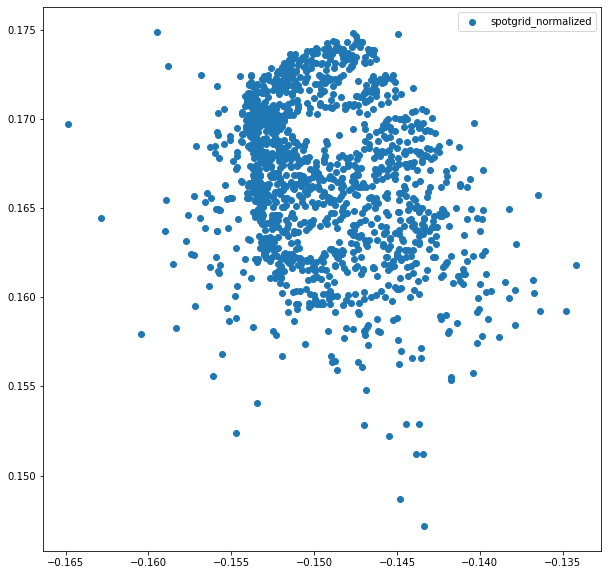

In [24]:
fig = plt.figure(figsize=(10,10))

for key in ["spotgrid_normalized"]:
    pylab.scatter(src[f"{key}_dx"],src[f"{key}_dy"],label=f"{key}")
pylab.legend()


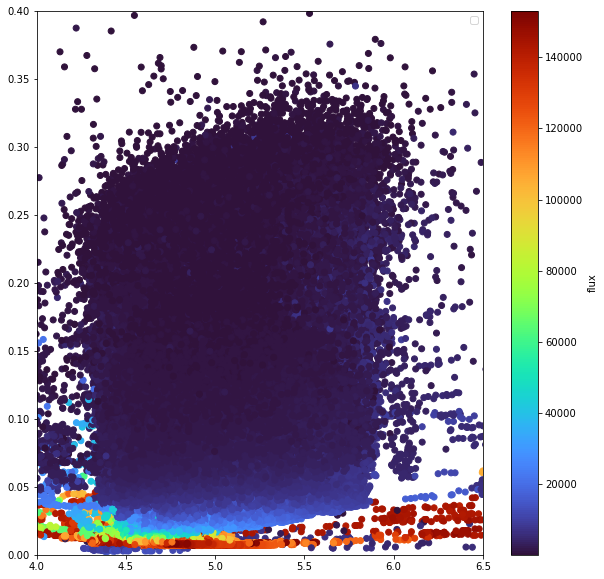

In [25]:
fig = plt.figure(figsize=(10,10))

for aresult in results[::1]:
    try:
#        raw = subbutler.get(aref)
#        src = subbutler.get("gridSpotSrc",dataId=aref.dataId)
#        img = raw.getImage().getArray()
#        md = raw.getMetadata()
        src=aresult["src"]

        scb=pylab.scatter(
            src["base_SdssShape_xx"],
            src["base_SdssShape_xxErr"],
            c=src["peakSignal"],
            cmap='turbo'
        )
        
    except:
#        pass
        raise
        
pylab.xlim(4,6.5)
pylab.ylim(0,0.4)
pylab.legend()
pylab.colorbar(scb,label="flux")